<a href="https://colab.research.google.com/github/rameshavinash94/Regression_Retail_Store/blob/main/Regression_CLassificaiton_Analysis_Assignment6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Olist store Retail Analysis - Classification/Regression Use cases**

**Our Business Problem:**

**Regression Problem:**
Predicting Delivery Date/Freight cost for product. Predicting the Delivery date/freight cost of a product based on various factors like zip code, distance,seller score,transportation, etc.

**Clasification Problem:**
Classifiing product category type based on product dimensions,price,freight cost and multiple factors.

### **INSTALLING LIBRARIES**

In [ ]:
#necessary packages
!pip install pycaret
!pip install autoviz
!pip install explainerdashboard
!pip install fast_ml
!pip install sweetviz

### **IMPORTING LIBRARIES**

In [ ]:
#capture warnings
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import plotly.express as px
from sklearn.cluster import AgglomerativeClustering

### **DATA EXTRACTION**

**Load the datasets**

In [ ]:
customers = pd.read_csv('olist_customers_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')
order_payment= pd.read_csv('olist_order_payments_dataset.csv')
geolocation = pd.read_csv('olist_geolocation_dataset.csv')
order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
orders = pd.read_csv('olist_orders_dataset.csv')
products = pd.read_csv('olist_products_dataset.csv')
sellers = pd.read_csv('olist_sellers_dataset.csv')
product_category_name = pd.read_csv('product_category_name_translation.csv')

The ER/Data Modeling Structure of the Datasource
<div>
<img src='https://i.imgur.com/HRhd2Y0.png'>
</div>


In [ ]:
#groupby zipcodes
location_info = geolocation.groupby('geolocation_zip_code_prefix').max().drop_duplicates().reset_index()

In [ ]:
#view the dataframe
location_info

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1001,-23.549292,-46.633559,são paulo,SP
1,1002,-23.544641,-46.633180,são paulo,SP
2,1003,-23.548901,-46.634862,são paulo,SP
3,1004,-23.549181,-46.634057,são paulo,SP
4,1005,-23.548758,-46.634768,são paulo,SP
...,...,...,...,...,...
18993,99960,-27.953409,-52.016483,charrua,RS
18994,99965,-28.173892,-52.034367,agua santa,RS
18995,99970,-28.341329,-51.870397,ciríaco,RS
18996,99980,-28.386239,-51.779942,david canabarro,RS


In [ ]:
#join with customers dataset
customers_location=pd.merge(customers,location_info,left_on='customer_zip_code_prefix',right_on='geolocation_zip_code_prefix').drop(columns=['geolocation_zip_code_prefix','geolocation_city','geolocation_state','customer_unique_id']).rename(columns={'geolocation_lat':'customer_lat','geolocation_lng':'customer_lng'})

In [ ]:
#view dataframe
customers_location.head()

,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,customer_lng
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409,franca,SP,-20.468849,-47.382173
1,5dca924cc99eea2dc5ba40d11ec5dd0f,14409,franca,SP,-20.468849,-47.382173
2,661897d4968f1b59bfff74c7eb2eb4fc,14409,franca,SP,-20.468849,-47.382173
3,702b62324327ccba20f1be3465426437,14409,franca,SP,-20.468849,-47.382173
4,bdf997bae7ca819b0415f5174d6b4302,14409,franca,SP,-20.468849,-47.382173


In [ ]:
#join with sellers dataset
seller_locations=pd.merge(sellers,location_info,left_on='seller_zip_code_prefix',right_on='geolocation_zip_code_prefix').drop(columns=['geolocation_zip_code_prefix','geolocation_city','geolocation_state']).rename(columns={'geolocation_lat':'seller_lat','geolocation_lng':'seller_lng'})

In [ ]:
#view dataframe
seller_locations.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state,seller_lat,seller_lng
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,-22.884842,-47.045846
1,e0eabded302882513ced4ea3eb0c7059,13023,campinas,SP,-22.884842,-47.045846
2,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP,-22.347646,-46.920804
3,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ,-22.864365,-43.170800
4,1d2732ef8321502ee8488e8bed1ab8cd,20031,rio de janeiro,RJ,-22.864365,-43.170800


In [ ]:
#view orders dataframe
orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [ ]:
#view order_review dataframe
order_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


**Perform Multiple joins to get the final resultant dataframe**

In [ ]:
product_info = pd.merge(order_items,products)

In [ ]:
product_info = pd.merge(product_info,product_category_name)

In [ ]:
order_product_info= pd.merge(orders,product_info)

In [ ]:
customers_orders=pd.merge(customers_location,order_product_info)

In [ ]:
final_Df = pd.merge(customers_orders,seller_locations)

In [ ]:
final_Df = final_Df[final_Df['order_status']=='delivered']

### **SIMPLE DATA WRANGLING**

In [ ]:
final_Df.isna().sum()

customer_id                       0
customer_zip_code_prefix          0
customer_city                     0
customer_state                    0
customer_lat                      0
customer_lng                      0
order_id                          0
order_status                      0
order_purchase_timestamp          0
order_approved_at                14
order_delivered_carrier_date      2
order_delivered_customer_date     8
order_estimated_delivery_date     0
order_item_id                     0
product_id                        0
seller_id                         0
shipping_limit_date               0
price                             0
freight_value                     0
product_category_name             0
product_name_lenght               0
product_description_lenght        0
product_photos_qty                0
product_weight_g                  1
product_length_cm                 1
product_height_cm                 1
product_width_cm                  1
product_category_name_englis

In [ ]:
# drop na and duplicates in df
final_Df = final_Df.dropna().drop_duplicates()

### **FEATURE ENGINEERING**

***CREATE NEW FEATURES FOR REGRESSION/CLASSIFICATION USE-CASES***

#### **DISTANCE BETWEEN 2 GEO LOCATIONS**

In [ ]:
def haversine_distance(lat1, lon1, lat2, lon2):
   r = 6371
   phi1 = np.radians(lat1)
   phi2 = np.radians(lat2)
   delta_phi = np.radians(np.array(lat2) - np.array(lat1))
   delta_lambda = np.radians(np.array(lon2) - np.array(lon1))
   a = np.sin(delta_phi / 2)**2 + np.cos(phi1) * np.cos(phi2) *   np.sin(delta_lambda / 2)**2
   res = r * (2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a)))
   return np.round(res*0.6214, 2)

In [ ]:
final_Df['distance']= haversine_distance(final_Df['customer_lat'],final_Df['customer_lng'],final_Df['seller_lat'],final_Df['seller_lng'])

In [ ]:
#VIEW THE DATAFRAME
final_Df.head()

,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,customer_lng,order_id,order_status,order_purchase_timestamp,order_approved_at,...,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state,seller_lat,seller_lng,distance
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409,franca,SP,-20.468849,-47.382173,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,...,54.0,64.0,31.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,218.13
1,4e7b3e00288586ebd08712fdd0374a03,1151,sao paulo,SP,-23.527788,-46.652997,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,...,52.0,52.0,17.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,19.00
2,b2b6027bc5c5109e529d4dc6358b12c3,8775,mogi das cruzes,SP,-23.493944,-46.172406,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,...,56.0,51.0,28.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,11.79
3,f2fdb2409d1c2b5018b19767572978d6,30575,belo horizonte,MG,-19.818637,-43.929691,930fb714ff2992c4ff14bf920af830e6,delivered,2017-12-03 14:52:12,2017-12-03 14:59:22,...,57.0,55.0,22.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,297.14
4,bf45a4524fffba803efa07f225cdfda5,20231,rio de janeiro,RJ,-22.908714,-43.182574,22167b7870f3c3b844087c5cbafac521,delivered,2018-03-07 17:56:08,2018-03-09 02:30:55,...,57.0,55.0,22.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,205.48


#### **Create Multiple Time Based Features**


**Actual Delivery Timeline** = _Difference in days between order_delivered_customer_date & order_purchase_timestamp._

**Estimated_delivery_timeline** = _Difference in days between order_delivered_customer_date & order_estimated_delivery_date if diff is less/zero then the customer is happy._

**Seller_approval_timeline** = _Difference in days between order_approved_at & order_purchase_timestamp. If the order gets approved faster then most probably the item is in stock and has higher chance of reaching on time._

**Seller_processing_timeline**  = _Difference in days between order_delivered_carrier_date & order_approved_at. Time taken by the seller to process the order._

**Seller_order_timeline** = _Difference in days between order_delivered_carrier_date & shipping_limit_date. if diff is less than seller is on track with the order._

**Carrier_delivery_timeline** = _Difference in days between order_delivered_customer_date & order_delivered_carrier_date. Time taken by the carrier to delive the order to the customer._

In [ ]:
#creating new features
final_Df[['order_delivered_customer_date','order_purchase_timestamp','order_estimated_delivery_date','order_approved_at','order_delivered_carrier_date','shipping_limit_date']] = final_Df[['order_delivered_customer_date','order_purchase_timestamp','order_estimated_delivery_date','order_approved_at','order_delivered_carrier_date','shipping_limit_date']].apply(pd.to_datetime) # conversion required
final_Df['actual_delivery_timeline']=(final_Df['order_delivered_customer_date'] - final_Df['order_purchase_timestamp']).dt.days
final_Df['estimated_delivery_timeline']=(final_Df['order_delivered_customer_date'] - final_Df['order_estimated_delivery_date']).dt.days
final_Df['seller_approval_timeline']= (final_Df['order_approved_at'] - final_Df['order_purchase_timestamp']).dt.days
final_Df['seller_processing_timeline'] = (final_Df['order_delivered_carrier_date'] - final_Df['order_approved_at']).dt.days
final_Df['seller_order_timeline'] =  (final_Df['order_delivered_carrier_date'] - final_Df['shipping_limit_date']).dt.days
final_Df['carrier_delivery_timeline'] = (final_Df['order_delivered_customer_date'] - final_Df['order_delivered_carrier_date']).dt.days

In [ ]:
#view the dataframe
final_Df.head()

,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,customer_lng,order_id,order_status,order_purchase_timestamp,order_approved_at,...,seller_state,seller_lat,seller_lng,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409,franca,SP,-20.468849,-47.382173,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,...,SP,-23.479473,-46.357851,218.13,8,-11,0,6,0,1
1,4e7b3e00288586ebd08712fdd0374a03,1151,sao paulo,SP,-23.527788,-46.652997,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,...,SP,-23.479473,-46.357851,19.00,26,1,1,21,5,3
2,b2b6027bc5c5109e529d4dc6358b12c3,8775,mogi das cruzes,SP,-23.493944,-46.172406,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,...,SP,-23.479473,-46.357851,11.79,14,-13,0,14,0,0
3,f2fdb2409d1c2b5018b19767572978d6,30575,belo horizonte,MG,-19.818637,-43.929691,930fb714ff2992c4ff14bf920af830e6,delivered,2017-12-03 14:52:12,2017-12-03 14:59:22,...,SP,-23.479473,-46.357851,297.14,25,-14,0,9,-1,15
4,bf45a4524fffba803efa07f225cdfda5,20231,rio de janeiro,RJ,-22.908714,-43.182574,22167b7870f3c3b844087c5cbafac521,delivered,2018-03-07 17:56:08,2018-03-09 02:30:55,...,SP,-23.479473,-46.357851,205.48,18,-29,1,11,-3,5


#### **CUSTOMER SATISFACTION**

_0 - Customer Satisfied with order delivery (ontime delivery)_

_1- Customer not satisfied with order delivery (late delivery )_

In [ ]:
final_Df['customer_satisfaction'] = np.where(final_Df['estimated_delivery_timeline'] <=0,0,1)

In [ ]:
final_Df

,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,customer_lng,order_id,order_status,order_purchase_timestamp,order_approved_at,...,seller_lat,seller_lng,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,customer_satisfaction
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409,franca,SP,-20.468849,-47.382173,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,...,-23.479473,-46.357851,218.13,8,-11,0,6,0,1,0
1,4e7b3e00288586ebd08712fdd0374a03,1151,sao paulo,SP,-23.527788,-46.652997,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,...,-23.479473,-46.357851,19.00,26,1,1,21,5,3,1
2,b2b6027bc5c5109e529d4dc6358b12c3,8775,mogi das cruzes,SP,-23.493944,-46.172406,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,...,-23.479473,-46.357851,11.79,14,-13,0,14,0,0,0
3,f2fdb2409d1c2b5018b19767572978d6,30575,belo horizonte,MG,-19.818637,-43.929691,930fb714ff2992c4ff14bf920af830e6,delivered,2017-12-03 14:52:12,2017-12-03 14:59:22,...,-23.479473,-46.357851,297.14,25,-14,0,9,-1,15,0
4,bf45a4524fffba803efa07f225cdfda5,20231,rio de janeiro,RJ,-22.908714,-43.182574,22167b7870f3c3b844087c5cbafac521,delivered,2018-03-07 17:56:08,2018-03-09 02:30:55,...,-23.479473,-46.357851,205.48,18,-29,1,11,-3,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110433,f48c503766cc6385fe6947e623c20b65,91791,porto alegre,RS,-30.144365,-51.125366,b13efaac3f8cb7730ba737059abc614b,delivered,2017-10-26 11:22:23,2017-10-26 11:37:48,...,-23.523698,-46.686732,532.93,13,-15,0,5,-1,8,0
110434,f48c503766cc6385fe6947e623c20b65,91791,porto alegre,RS,-30.144365,-51.125366,b13efaac3f8cb7730ba737059abc614b,delivered,2017-10-26 11:22:23,2017-10-26 11:37:48,...,-23.523698,-46.686732,532.93,13,-15,0,5,-1,8,0
110435,f48c503766cc6385fe6947e623c20b65,91791,porto alegre,RS,-30.144365,-51.125366,b13efaac3f8cb7730ba737059abc614b,delivered,2017-10-26 11:22:23,2017-10-26 11:37:48,...,-23.523698,-46.686732,532.93,13,-15,0,5,-1,8,0
110436,f48c503766cc6385fe6947e623c20b65,91791,porto alegre,RS,-30.144365,-51.125366,b13efaac3f8cb7730ba737059abc614b,delivered,2017-10-26 11:22:23,2017-10-26 11:37:48,...,-23.523698,-46.686732,532.93,13,-15,0,5,-1,8,0


In [ ]:
#VIEW THE COLUMNS
final_Df.columns

Index(['customer_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'customer_lat', 'customer_lng', 'order_id',
       'order_status', 'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'seller_lat', 'seller_lng', 'distance',
       'actual_delivery_timeline', 'estimated_delivery_timeline',
       'seller_approval_timeline', 'seller_processing_timeline',
       'seller_order_timeline', 'carrier_delivery_timeline',
       'customer_satisfaction'],
      dt

#### **Determine The Density Of The Order**

_Density is an important feature in logstics since it helps to decide the freight class of the product._

*The formula to determine the density of an item is: LxWxH / 1728 = Cubic Feet (CU FT), Weight (Pounds)/CU FT = Density (#PCF)*

In [ ]:
#density calculation function
def density(l,w,h,weight):
    l=np.array(l)*0.393701 # to convert to inches
    w=np.array(w)*0.393701
    h=np.array(h)*0.393701
    Cubic_feet = l*w*h/1728
    Density = (np.array(weight)*0.00220462)/Cubic_feet
    return np.round(Density,2)

In [ ]:
final_Df['pkg_density']=density(final_Df['product_length_cm'],final_Df['product_width_cm'],final_Df['product_height_cm'],final_Df['product_weight_g'])

In [ ]:
final_Df['pkg_density'].head()

0     5.06
1    11.23
2     9.49
3    10.75
4    11.93
Name: pkg_density, dtype: float64

#### **SELLER_RELIABILITY_CREATION**


_FACTORS:_
- ORDER APPROVAL TIME
- PRODUCT QUALITY/CUSTOMER SATISFACTION
- SHIPPING TIMELINE TO CARRIER

In [ ]:
#merge the final dataframe with order_reviews to get the review info of each order
Review_info = final_Df.merge(order_reviews)

In [ ]:
seller_review_score = Review_info.groupby('seller_id')['review_score'].mean().round(1).to_frame().reset_index()

In [ ]:
seller_review_score['review_score'] = np.round(seller_review_score['review_score']/5,1)

In [ ]:
#seller review score
seller_review_score

,seller_id,review_score
0,0015a82c2db000af6aaaf3ae2ecb0532,0.7
1,001cca7ae9ae17fb1caed9dfb1094831,0.8
2,002100f778ceb8431b7a1020ff7ab48f,0.8
3,004c9cd9d87a3c30c522c48c4fc07416,0.8
4,00720abe85ba0859807595bbf045a33b,0.7
...,...,...
2895,ffc470761de7d0232558ba5e786e57b7,0.9
2896,ffdd9f82b9a447f6f8d4b91554cc7dd3,0.8
2897,ffeee66ac5d5a62fe688b9d26f83f534,0.8
2898,fffd5413c0700ac820c7069d66d98c89,0.8


In [ ]:
#calcuate seller ontime and approval time scores
final_Df['seller_on_time'] = np.where(final_Df['seller_order_timeline'] > 0,0,1)
final_Df['seller_order_approval_time'] = np.where(final_Df['seller_approval_timeline'] <= 2,1,0)

In [ ]:
seller_on_time = final_Df.groupby('seller_id')['seller_on_time'].mean().round(1).to_frame().reset_index()
seller_approval_score = final_Df.groupby('seller_id')['seller_order_approval_time'].mean().round(1).to_frame().reset_index()

In [ ]:
#create a new dataframe with combination of 3 scores(seller_on_time,seller_order_approval_time,review_score)
seller_reliability_info = pd.merge(pd.merge(seller_on_time,seller_approval_score),seller_review_score)

In [ ]:
#create a new column reliabilty score with a combined probability of all 3 columns
seller_reliability_info['reliabilty_score'] = 0.5*seller_reliability_info['seller_on_time']+0.3*seller_reliability_info['review_score']+0.2*seller_reliability_info['seller_order_approval_time']

In [ ]:
#view dataframe
seller_reliability_info.head()

,seller_id,seller_on_time,seller_order_approval_time,review_score,reliabilty_score
0,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91
1,001cca7ae9ae17fb1caed9dfb1094831,1.0,1.0,0.8,0.94
2,002100f778ceb8431b7a1020ff7ab48f,0.9,1.0,0.8,0.89
3,004c9cd9d87a3c30c522c48c4fc07416,1.0,1.0,0.8,0.94
4,00720abe85ba0859807595bbf045a33b,0.9,1.0,0.7,0.86


In [ ]:
#now merge the seller_reliability_info with final dataframe for the regression model
Combined_Df = pd.merge(seller_reliability_info,final_Df)

In [ ]:
#view the joined df
Combined_Df

,seller_id,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,...,seller_lng,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,customer_satisfaction,pkg_density
0,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91,d9442164acf4b03109425633efaa0cfc,38600,paracatu,MG,-17.117508,...,-46.532709,449.92,12,-13,0,5,-1,7,0,11.90
1,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91,944b72539d7e1f7f7fc6e46639ef1fe3,87502,umuarama,PR,-23.750819,...,-46.532709,421.79,10,-23,1,1,-14,8,0,11.90
2,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91,d7fc82cbeafea77bd0a8fbbf6296e387,35490,entre rios de minas,MG,-20.658067,...,-46.532709,259.16,9,-13,0,1,-5,7,0,11.90
3,001cca7ae9ae17fb1caed9dfb1094831,1.0,1.0,0.8,0.94,1fff5bd495b4e1ccb35d4a2b51520803,89254,jaragua do sul,SC,-26.448030,...,-40.390723,698.42,15,-17,0,6,0,9,0,28.58
4,001cca7ae9ae17fb1caed9dfb1094831,1.0,1.0,0.8,0.94,a37f4486aff8b096c3878e83a2ae0f1a,39400,montes claros,MG,-16.671011,...,-40.390723,335.03,9,-14,0,1,-3,8,0,28.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73784,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,afc9910dda523bd3e6b83bfa889bbbc4,64606,picos,PI,-7.080298,...,-46.781083,1136.10,18,-15,0,3,-3,15,0,10.97
73785,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,043f84c471d1141aa553fc893c6fa14c,94760,aguas claras,RS,-19.435588,...,-46.781083,354.79,37,2,0,0,-6,35,1,7.17
73786,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,4aefbb772ae619de2cc832a2d7526ff6,15980,dobrada,SP,-21.513888,...,-46.781083,130.95,3,-14,0,1,-5,2,0,10.97
73787,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,a4c800a16c71d3bb4b77665ba11d8525,36923,luisburgo,MG,-20.438173,...,-46.781083,338.45,10,-13,0,2,-2,8,0,17.86


In [ ]:
Combined_Df.columns

Index(['seller_id', 'seller_on_time', 'seller_order_approval_time',
       'review_score', 'reliabilty_score', 'customer_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'customer_lat', 'customer_lng', 'order_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'shipping_limit_date', 'price', 'freight_value',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'seller_lat', 'seller_lng', 'distance',
       'actual_delivery_timeline', 'estimated_delivery_timeline',
       'seller_approval_timeline', 'seller_processing_timeline',
    

In [ ]:
#remove the unnecessary columns
regression_test = Combined_Df.drop(columns=['order_purchase_timestamp','order_approved_at','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date','seller_id', 'shipping_limit_date','product_category_name','product_name_lenght','product_description_lenght', 'product_photos_qty','customer_city','customer_state', 'customer_lat', 'customer_lng','seller_city', 'seller_state', 'seller_lat','seller_lng','order_status','order_id','order_item_id','product_id'])

In [ ]:
#view the dataframe
regression_test

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_id,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,...,seller_zip_code_prefix,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,customer_satisfaction,pkg_density
0,1.0,1.0,0.7,0.91,d9442164acf4b03109425633efaa0cfc,38600,895.0,21.02,11800.0,40.0,...,9080,449.92,12,-13,0,5,-1,7,0,11.90
1,1.0,1.0,0.7,0.91,944b72539d7e1f7f7fc6e46639ef1fe3,87502,895.0,21.02,11800.0,40.0,...,9080,421.79,10,-23,1,1,-14,8,0,11.90
2,1.0,1.0,0.7,0.91,d7fc82cbeafea77bd0a8fbbf6296e387,35490,895.0,21.02,11800.0,40.0,...,9080,259.16,9,-13,0,1,-5,7,0,11.90
3,1.0,1.0,0.8,0.94,1fff5bd495b4e1ccb35d4a2b51520803,89254,99.0,45.99,9000.0,42.0,...,29156,698.42,15,-17,0,6,0,9,0,28.58
4,1.0,1.0,0.8,0.94,a37f4486aff8b096c3878e83a2ae0f1a,39400,99.0,38.53,9000.0,42.0,...,29156,335.03,9,-14,0,1,-3,8,0,28.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73784,1.0,1.0,0.8,0.94,afc9910dda523bd3e6b83bfa889bbbc4,64606,262.5,206.45,25850.0,38.0,...,13908,1136.10,18,-15,0,3,-3,15,0,10.97
73785,1.0,1.0,0.8,0.94,043f84c471d1141aa553fc893c6fa14c,94760,95.8,21.16,2250.0,40.0,...,13908,354.79,37,2,0,0,-6,35,1,7.17
73786,1.0,1.0,0.8,0.94,4aefbb772ae619de2cc832a2d7526ff6,15980,262.5,57.51,25850.0,38.0,...,13908,130.95,3,-14,0,1,-5,2,0,10.97
73787,1.0,1.0,0.8,0.94,a4c800a16c71d3bb4b77665ba11d8525,36923,98.0,17.83,5150.0,20.0,...,13908,338.45,10,-13,0,2,-2,8,0,17.86


In [ ]:
#created a simple map of product category
product_category_dictinary = {y:x for x,y in enumerate(regression_test['product_category_name_english'].unique())}

#regression_test['product_category_name_english'] = regression_test['product_category_name_english'].map(product_category_dictinary)

In [ ]:
cleaned_regression = regression_test.dropna().drop_duplicates()

In [ ]:
#testing regression
testing_regression=cleaned_regression.drop(columns=['estimated_delivery_timeline'])

**WRITE INTERMEDIATE RESULTS TO CSV**

In [ ]:
#write to csv for intermediate steps
testing_regression.to_csv("testing_regression.csv",index=False)

### **REGRESSION**

#### ***COMBINE WITH ON THE GOLDEN CLUSTER AND PERFROM REGRESSION***

In [ ]:
Regression_dataset = pd.read_csv('/content/testing_regression.csv')

In [ ]:
GOlder_Cluster=pd.read_csv('/content/Golden_Cluster.csv')

**Combine this dataset to the previous created customers on the verge of Churn**

In [ ]:
#now lets merge only the customers who are on the verge of churn from previous clustering usecase
Regression_Df = pd.merge(Regression_dataset,GOlder_Cluster)

In [ ]:
Regression_Df

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_id,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,...,carrier_delivery_timeline,customer_satisfaction,pkg_density,MonetaryValue,Frequency,Recently,Frequency_Cluster_Category,Recency_Cluster_Category,Monetary_Cluster_Category,churn_customer_category
0,1.0,1.0,0.9,0.97,753bd08248a5fa2c21da47c01cfd83a3,11065,62.0,2.34,625.0,70.0,...,1,0,0.74,1.039471,5.423270,0.465797,1,1,1,MS
1,1.0,1.0,0.9,0.97,07e6bfcde64d35a92aeea73af4a36411,13503,95.0,11.29,4250.0,50.0,...,0,0,5.41,1.540398,3.525586,-0.508316,1,2,1,MS
2,1.0,1.0,0.9,0.97,aeb3d464f6b83eecd79d6fd58d6208fb,8041,62.0,10.54,625.0,70.0,...,4,0,0.74,3.213548,13.014007,-0.113405,3,2,0,HS
3,1.0,1.0,0.9,0.97,aeb3d464f6b83eecd79d6fd58d6208fb,8041,48.0,10.54,475.0,65.0,...,4,0,2.53,3.213548,13.014007,-0.113405,3,2,0,HS
4,1.0,1.0,0.9,0.97,bb57526f1e8fe74f92c4c7e4ced09303,14340,127.0,13.91,1850.0,70.0,...,6,0,1.94,3.533764,5.423270,-0.021259,1,2,0,HS
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
471,1.0,1.0,0.8,0.94,5c351d3b7eb465775ce1405dbe49cb23,15093,115.0,8.59,200.0,26.0,...,1,0,2.45,3.508762,3.525586,-0.679444,1,2,0,HS
472,1.0,1.0,0.8,0.94,5c351d3b7eb465775ce1405dbe49cb23,15093,229.9,8.59,250.0,26.0,...,1,0,2.34,3.508762,3.525586,-0.679444,1,2,0,HS
473,1.0,1.0,0.9,0.97,2b832cd4b84a4df8934118d2d0c3dabc,12288,16.8,11.85,148.0,25.0,...,4,0,0.62,-0.123142,5.423270,0.571107,1,1,3,SHS
474,1.0,1.0,0.9,0.97,17a591e12299eb96e17f2986c3e2879c,14021,69.5,13.51,1100.0,24.0,...,2,0,4.97,0.971633,3.525586,0.268342,1,1,1,MS


#### **USECASE1 - DELIVERY DATE ESTIMATION**

##### **DIFFERENT FEATURES IN THE DATASET**

In [ ]:
X=Regression_Df.drop(columns=['actual_delivery_timeline','product_category_name_english','customer_id','churn_customer_category'])
y=Regression_Df['actual_delivery_timeline']

In [ ]:
#features in the dataset
feature_name=X.columns
feature_name

Index(['seller_on_time', 'seller_order_approval_time', 'review_score',
       'reliabilty_score', 'customer_zip_code_prefix', 'price',
       'freight_value', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix',
       'distance', 'seller_approval_timeline', 'seller_processing_timeline',
       'seller_order_timeline', 'carrier_delivery_timeline',
       'customer_satisfaction', 'pkg_density', 'MonetaryValue', 'Frequency',
       'Recently', 'Frequency_Cluster_Category', 'Recency_Cluster_Category',
       'Monetary_Cluster_Category'],
      dtype='object')

##### **DIFFERENT FEATURE SELECTION METHODS**

######**Pearson Correlation**

In [ ]:
def cor_selector(X, y,num_feats):
    cor_list = []
    feature_name = X.columns.tolist()
    # calculate the correlation with y for each feature
    cor_list = X.corrwith(y)
    # replace NaN with 0
    cor_list = [0 if np.isnan(i) else i for i in cor_list]
    # feature name
    cor_feature = X.iloc[:,np.argsort(np.abs(cor_list))[-num_feats:]].columns.tolist()
    # feature selection? 0 for not select, 1 for select
    cor_support = [True if i in cor_feature else False for i in feature_name]
    return cor_support, cor_feature

In [ ]:
import numpy as np
num_feats=10
cor_support, cor_feature = cor_selector(X, y,num_feats)
print(str(len(cor_feature)), 'selected features')

10 selected features


In [ ]:
for x in cor_feature:
  print(x)

seller_approval_timeline
MonetaryValue
freight_value
Monetary_Cluster_Category
seller_zip_code_prefix
seller_order_timeline
customer_satisfaction
distance
seller_processing_timeline
carrier_delivery_timeline


######**CHI-SQUARED**

In [ ]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.preprocessing import MinMaxScaler
X_norm = MinMaxScaler().fit_transform(X)
chi_selector = SelectKBest(chi2, k=num_feats)
chi_selector.fit(X_norm, y)
chi_support = chi_selector.get_support()
chi_feature = X.loc[:,chi_support].columns.tolist()
print(str(len(chi_feature)), 'selected features')

10 selected features


In [ ]:
for x in cor_feature:
  print(x)

seller_approval_timeline
MonetaryValue
freight_value
Monetary_Cluster_Category
seller_zip_code_prefix
seller_order_timeline
customer_satisfaction
distance
seller_processing_timeline
carrier_delivery_timeline


######**Recursive Feature Elimination**

In [ ]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
rfe_selector = RFE(estimator=LogisticRegression(), n_features_to_select=num_feats, step=10, verbose=5)
rfe_selector.fit(X_norm, y)
rfe_support = rfe_selector.get_support()
rfe_feature = X.loc[:,rfe_support].columns.tolist()
print(str(len(rfe_feature)), 'selected features')

Fitting estimator with 25 features.
Fitting estimator with 15 features.
10 selected features


In [ ]:
rfe_feature

['customer_zip_code_prefix',
 'product_width_cm',
 'seller_zip_code_prefix',
 'distance',
 'seller_approval_timeline',
 'seller_processing_timeline',
 'seller_order_timeline',
 'carrier_delivery_timeline',
 'MonetaryValue',
 'Frequency']

######**Lasso: SelectFromModel**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LogisticRegression

embeded_lr_selector = SelectFromModel(LogisticRegression(penalty="l2"), max_features=num_feats)
embeded_lr_selector.fit(X_norm, y)

embeded_lr_support = embeded_lr_selector.get_support()
embeded_lr_feature = X.loc[:,embeded_lr_support].columns.tolist()
print(str(len(embeded_lr_feature)), 'selected features')

9 selected features


In [ ]:
embeded_lr_feature

['customer_zip_code_prefix',
 'product_width_cm',
 'seller_zip_code_prefix',
 'distance',
 'seller_approval_timeline',
 'seller_processing_timeline',
 'seller_order_timeline',
 'carrier_delivery_timeline',
 'Monetary_Cluster_Category']

######**Tree-based: SelectFromModel**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier

embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=100), max_features=num_feats)
embeded_rf_selector.fit(X, y)

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = X.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features')

10 selected features


In [ ]:
embeded_rf_feature

['customer_zip_code_prefix',
 'price',
 'freight_value',
 'seller_zip_code_prefix',
 'distance',
 'seller_processing_timeline',
 'seller_order_timeline',
 'carrier_delivery_timeline',
 'MonetaryValue',
 'Recently']

###### **COMBINE ALL METHODS AND CHOOSE TOP N FEATURES**

In [ ]:
# put all selection together
feature_selection_df = pd.DataFrame({'Feature':feature_name, 'Pearson':cor_support, 'Chi-2':chi_support, 'RFE':rfe_support, 'Logistics':embeded_lr_support,
                                    'Random Forest':embeded_rf_support})
# count the selected times for each feature
feature_selection_df['Total'] = np.sum(feature_selection_df, axis=1)
# display the top 100
feature_selection_df = feature_selection_df.sort_values(['Total','Feature'] , ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df)+1)

In [ ]:
feature_selection_df

,Feature,Pearson,Chi-2,RFE,Logistics,Random Forest,Total
1,seller_zip_code_prefix,True,True,True,True,True,5
2,seller_processing_timeline,True,True,True,True,True,5
3,distance,True,True,True,True,True,5
4,carrier_delivery_timeline,True,True,True,True,True,5
5,seller_order_timeline,True,False,True,True,True,4
6,seller_approval_timeline,True,True,True,True,False,4
7,customer_zip_code_prefix,False,False,True,True,True,3
8,MonetaryValue,True,False,True,False,True,3
9,product_width_cm,False,False,True,True,False,2
10,freight_value,True,False,False,False,True,2


In [ ]:
#select top 10 features
final_features = feature_selection_df[:12]['Feature']

In [ ]:
final_features = final_features.values

In [ ]:
final_features

array(['seller_zip_code_prefix', 'seller_processing_timeline', 'distance',
       'carrier_delivery_timeline', 'seller_order_timeline',
       'seller_approval_timeline', 'customer_zip_code_prefix',
       'MonetaryValue', 'product_width_cm', 'freight_value',
       'customer_satisfaction', 'Monetary_Cluster_Category'], dtype=object)

In [ ]:
#columns to drop
drop_columns=[]

for col in X.columns:
  if col in final_features:
    pass
  else:
    drop_columns.append(col)

In [ ]:
drop_columns

['seller_on_time',
 'seller_order_approval_time',
 'review_score',
 'reliabilty_score',
 'price',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'pkg_density',
 'Frequency',
 'Recently',
 'Frequency_Cluster_Category',
 'Recency_Cluster_Category']

In [ ]:
#drop unnecessary features 
Final_X = X.drop(columns=drop_columns)

In [ ]:
#dataframe with only the required features
Final_X

,customer_zip_code_prefix,freight_value,product_width_cm,seller_zip_code_prefix,distance,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,customer_satisfaction,MonetaryValue,Monetary_Cluster_Category
0,11065,2.34,50.0,3333,31.27,0,2,-3,1,0,1.039471,1
1,13503,11.29,70.0,3333,101.60,0,2,-3,0,0,1.540398,1
2,8041,10.54,50.0,3333,9.05,1,1,-5,4,0,3.213548,0
3,8041,10.54,45.0,3333,9.05,1,1,-5,4,0,3.213548,0
4,14340,13.91,50.0,3333,190.72,0,1,-5,6,0,3.533764,0
...,...,...,...,...,...,...,...,...,...,...,...,...
471,15093,8.59,14.0,15015,161.46,0,-1,-8,1,0,3.508762,0
472,15093,8.59,16.0,15015,161.46,0,-1,-8,1,0,3.508762,0
473,12288,11.85,22.0,13920,65.74,0,0,-6,4,0,-0.123142,3
474,14021,13.51,24.0,13920,126.59,1,0,-6,2,0,0.971633,1


##### **TRAIN TEST SPLIT**

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(Final_X, y, test_size=0.2, random_state=21)

##### **VISUALIZE TRAIN TEST SPLIT**

**SWEETVIZ**

In [ ]:
# importing sweetviz
import sweetviz as sv

training_date = X_train
training_date['delivery_date']= y_train

testing_data = X_test
testing_data['delivery_date']= y_test

#compare train and test
comparison_report = sv.compare([training_date,'Train'], [testing_data,'Test'])

                                             |          | [  0%]   00:00 -> (? left)


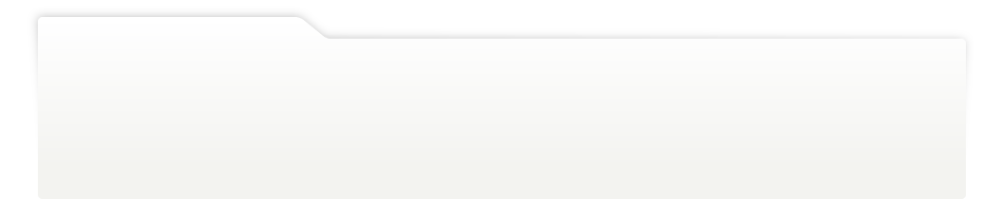
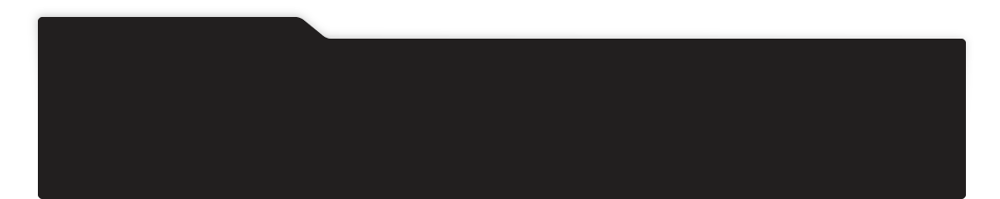
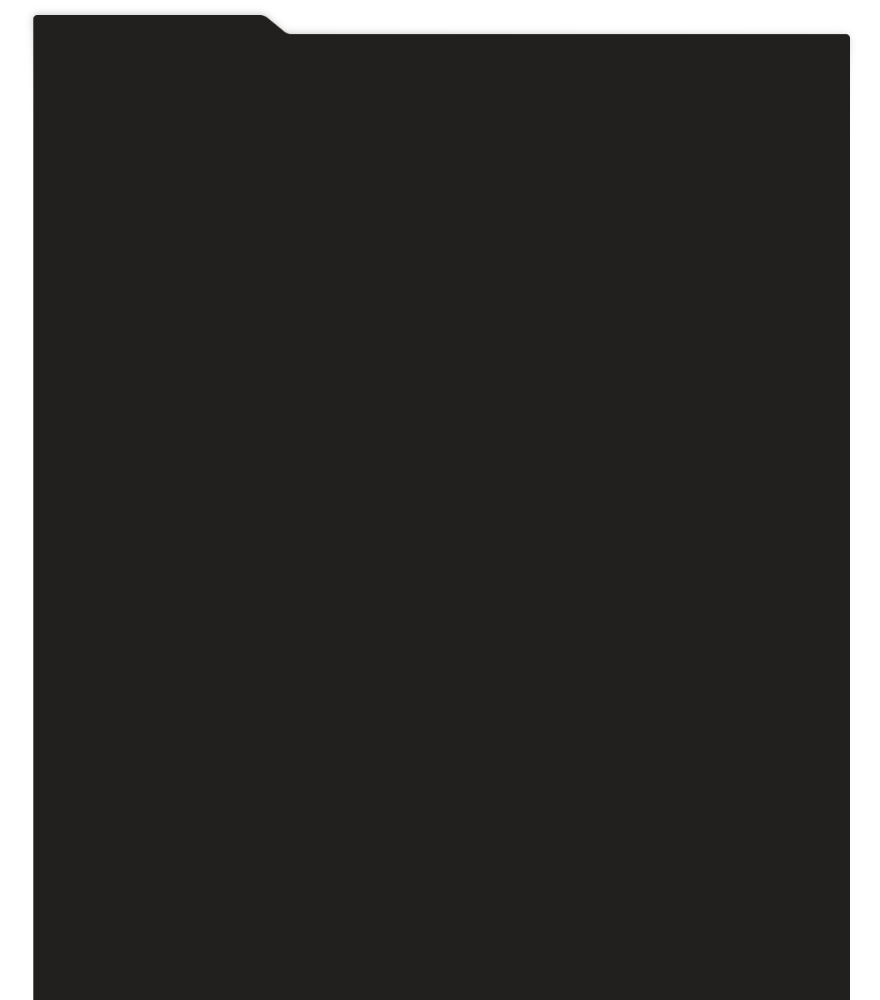
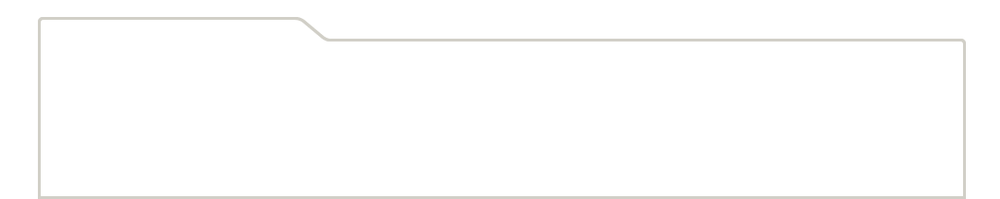
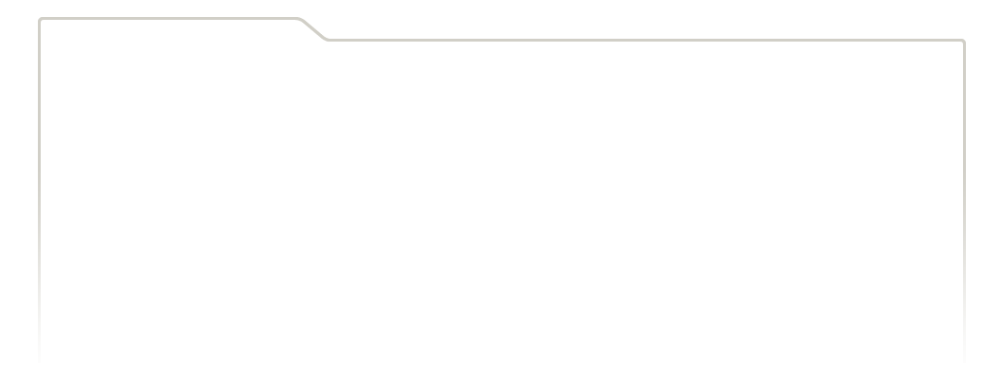
...
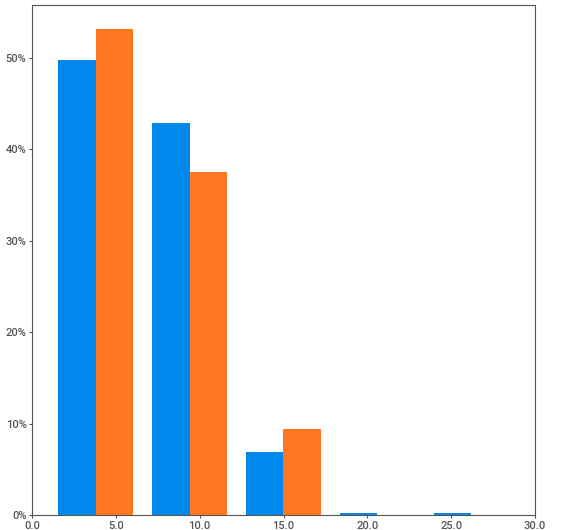
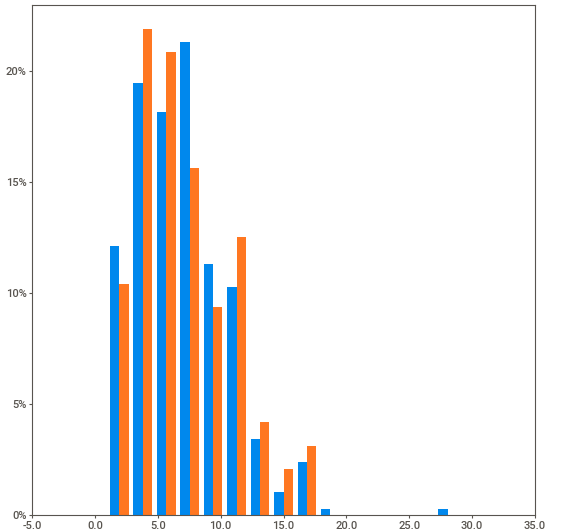
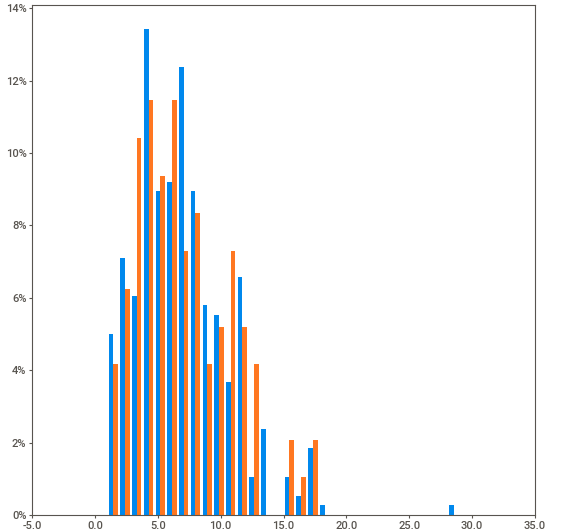
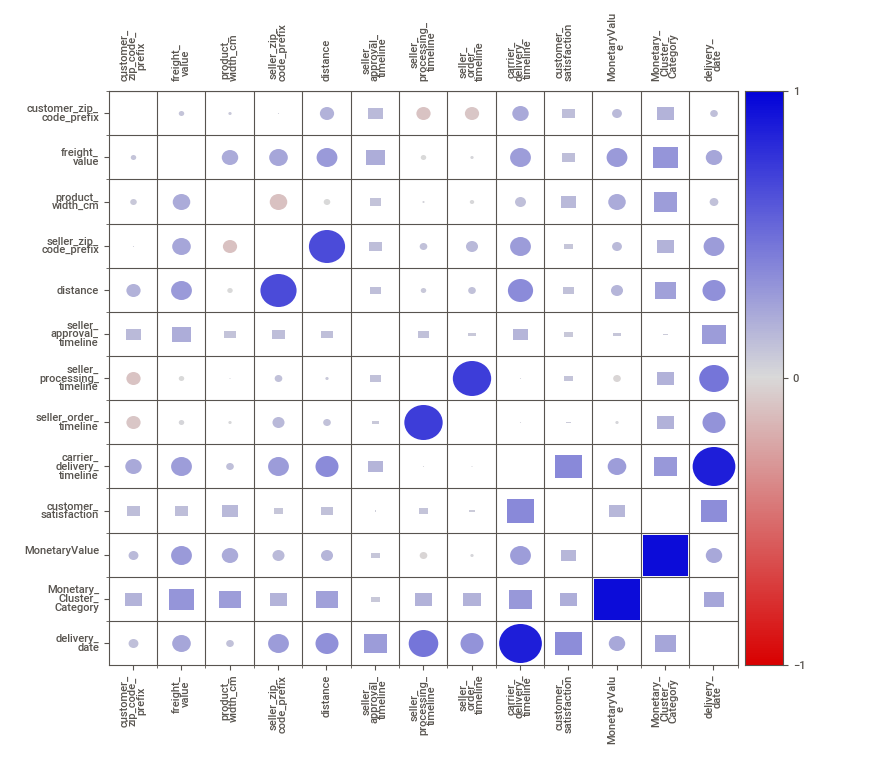
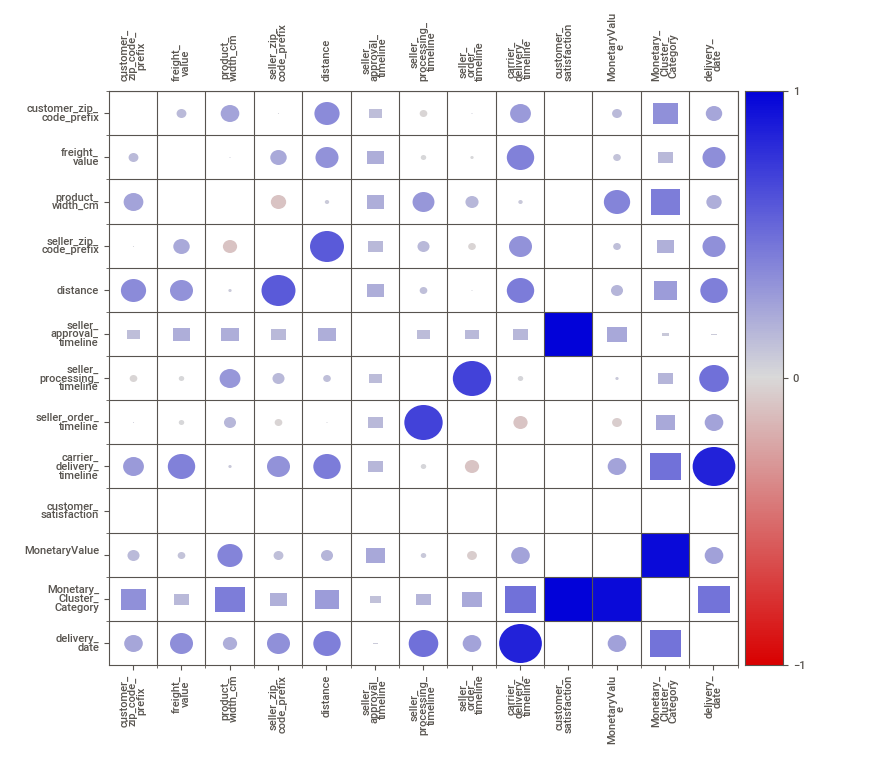

In [ ]:
comparison_report.show_notebook() # Using the default values (w="100%", h=750, layout="vertical"), all can be overridden in an INI, see below)

##### **ML MODELS**

###### **PYCARET AUTOML FOR DIFFERENT ML MODEL PERFORMANCE**

In [ ]:
from pycaret.regression import *

In [ ]:
Reg_Df = Final_X
Reg_Df['actual_delivery_timeline']=y

In [ ]:
Reg_Df.head()

,customer_zip_code_prefix,freight_value,product_width_cm,seller_zip_code_prefix,distance,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,customer_satisfaction,MonetaryValue,Monetary_Cluster_Category,actual_delivery_timeline
0,11065,2.34,50.0,3333,31.27,0,2,-3,1,0,1.039471,1,4
1,13503,11.29,70.0,3333,101.60,0,2,-3,0,0,1.540398,1,3
2,8041,10.54,50.0,3333,9.05,1,1,-5,4,0,3.213548,0,8
3,8041,10.54,45.0,3333,9.05,1,1,-5,4,0,3.213548,0,8
4,14340,13.91,50.0,3333,190.72,0,1,-5,6,0,3.533764,0,7


In [ ]:
#setup pycaret
exp_name = setup(data = Reg_Df,  target = 'actual_delivery_timeline',normalize=True,silent=True)

,Description,Value
0,session_id,7835
1,Target,actual_delivery_timeline
2,Original Data,"(476, 13)"
3,Missing Values,False
4,Numeric Features,6
5,Categorical Features,6
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(333, 54)"


In [ ]:
best_reg_model = compare_models(fold=5)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,5.443000e-01,4.658000e-01,6.780000e-01,9.637000e-01,0.1095,0.1117,0.986
br,Bayesian Ridge,5.514000e-01,4.746000e-01,6.841000e-01,9.630000e-01,0.1107,0.1146,0.020
huber,Huber Regressor,5.624000e-01,6.090000e-01,7.705000e-01,9.547000e-01,0.1135,0.1108,0.054
par,Passive Aggressive Regressor,6.945000e-01,8.696000e-01,9.314000e-01,9.336000e-01,0.1609,0.1576,0.018
ridge,Ridge Regression,7.148000e-01,9.181000e-01,9.485000e-01,9.314000e-01,0.1468,0.1575,0.016
gbr,Gradient Boosting Regressor,9.021000e-01,1.520500e+00,1.217800e+00,8.865000e-01,0.1895,0.2059,0.106
et,Extra Trees Regressor,7.452000e-01,1.873100e+00,1.355800e+00,8.630000e-01,0.2028,0.1312,0.516
lightgbm,Light Gradient Boosting Machine,1.155300e+00,2.931600e+00,1.677700e+00,7.859000e-01,0.2360,0.2475,0.172
rf,Random Forest Regressor,1.212300e+00,3.228200e+00,1.752300e+00,7.654000e-01,0.2438,0.2634,0.630
ada,AdaBoost Regressor,2.053800e+00,6.243400e+00,2.484500e+00,5.355000e-01,0.3867,0.5306,0.104


###### **MULLER LOOP**

In [ ]:
#standardization
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_norm = scaler.fit_transform(X_train)
X_test_norm = scaler.fit_transform(X_test)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import BayesianRidge
from sklearn.neural_network import MLPRegressor
from time import time
from sklearn.metrics import r2_score

names = ["RandomForestRegressor",
         "DecisionTreeRegressor", "SVR", "LinearRegression", "Ridge",
         "BayesianRidge","MLPRegressor"]

classifiers = [
    RandomForestRegressor(max_depth=2, random_state=0),
    DecisionTreeRegressor(max_depth=2, random_state=0),
    SVR(epsilon=0.2),
    LinearRegression(),
    Ridge(alpha=1.0),
    BayesianRidge(),
    MLPRegressor(random_state=1, max_iter=5000)
    ]

max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time()
    clf.fit(X_train_norm, y_train)
    ypred = clf.predict(X_test_norm)
    score = 100.0 * r2_score(y_test, ypred, multioutput='variance_weighted')
    print('Regression = %s, R2 Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time() - start_time))
    
    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Regression = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))
#plot the output of the various algorithms

Regression = RandomForestRegressor, R2 Score (test, accuracy) = 95.47, Training time = 0.18 seconds
Regression = DecisionTreeRegressor, R2 Score (test, accuracy) = 91.41, Training time = 0.00 seconds
Regression = SVR, R2 Score (test, accuracy) = 92.28, Training time = 0.02 seconds
Regression = LinearRegression, R2 Score (test, accuracy) = 99.97, Training time = 0.00 seconds
Regression = Ridge, R2 Score (test, accuracy) = 99.96, Training time = 0.01 seconds
Regression = BayesianRidge, R2 Score (test, accuracy) = 99.97, Training time = 0.00 seconds
Regression = MLPRegressor, R2 Score (test, accuracy) = 98.86, Training time = 2.83 seconds
--------------------------------------------------------------------------------
Best --> Regression = BayesianRidge, Score (test, accuracy) = 99.97


##### **INTERACTIVE DASHBOARDS**

In [ ]:
#RandomForestRegressor
model1 = RandomForestRegressor(max_depth=2, random_state=0)
model1.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=2, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=0, verbose=0, warm_start=False)

In [ ]:
#DecisionTreeRegressor
model2 = DecisionTreeRegressor(max_depth=2, random_state=0)
model2.fit(X_train, y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=0, splitter='best')

In [ ]:
#SVR
model3 = SVR(epsilon=0.2)
model3.fit(X_train, y_train)

SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.2, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
#Linear Regression
model4 = LinearRegression()
model4.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
#Creating Dashbord
from explainerdashboard import RegressionExplainer,ExplainerDashboard,ExplainerHub
explainer1 = RegressionExplainer(model1, X_test,y_test)
explainer2 = RegressionExplainer(model2, X_test,y_test)
explainer3 = RegressionExplainer(model3, X_test,y_test)
explainer4 = RegressionExplainer(model4, X_test,y_test)

Changing class type to RandomForestRegressionExplainer...
Generating self.shap_explainer = shap.TreeExplainer(model)
Generating self.shap_explainer = shap.TreeExplainer(model)
Generating self.shap_explainer = shap.KernelExplainer(model, X)...
Generating self.shap_explainer = shap.LinearExplainer(modelX)...


In [ ]:
db1 = ExplainerDashboard(explainer1)
db2 = ExplainerDashboard(explainer2)
db3 = ExplainerDashboard(explainer2)
db4 = ExplainerDashboard(explainer2)

Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
Generating layout...
Calculating shap values...
Calculating predictions...
Calculating residuals...
Calculating absolute residuals...
Calculating shap interaction values...
Reminder: TreeShap computational complexity is O(TLD^2), where T is the number of trees, L is the maximum number of leaves in any tree and D the maximal depth of any tree. So reducing these will speed up the calculation.
Calculating dependencies...
Calculating importances...
Calculating ShadowDecTree for each individual decision tree...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating l

**EXPLAINERDASHBOARD**

In [ ]:
db1.run(mode='inline')

Starting ExplainerDashboard inline (terminate it with ExplainerDashboard.terminate(8050))


<IPython.core.display.Javascript object>

In [ ]:
db2.run(mode='inline')

Starting ExplainerDashboard inline (terminate it with ExplainerDashboard.terminate(8050))


<IPython.core.display.Javascript object>

**EXPLAINERHUB**

In [ ]:
#run dashboard
#hub = ExplainerHub([db1, db2, db3, db4])
#hub.run()

#### **USECASE2 - FREIGHT VALUE PREDICTION**

##### **DIFFERENT FEATURES IN THE DATASET**

In [ ]:
X=Regression_Df.drop(columns=['freight_value','product_category_name_english','customer_id','churn_customer_category'])
y=Regression_Df['freight_value']

In [ ]:
#features in the dataset
feature_name=X.columns
X.dtypes

seller_on_time                float64
seller_order_approval_time    float64
review_score                  float64
reliabilty_score              float64
customer_zip_code_prefix        int64
price                         float64
product_weight_g              float64
product_length_cm             float64
product_height_cm             float64
product_width_cm              float64
seller_zip_code_prefix          int64
distance                      float64
actual_delivery_timeline        int64
seller_approval_timeline        int64
seller_processing_timeline      int64
seller_order_timeline           int64
carrier_delivery_timeline       int64
customer_satisfaction           int64
pkg_density                   float64
MonetaryValue                 float64
Frequency                     float64
Recently                      float64
Frequency_Cluster_Category      int64
Recency_Cluster_Category        int64
Monetary_Cluster_Category       int64
dtype: object

##### **DIFFERENT FEATURE SELECTION METHODS**

######**Pearson Correlation**

In [ ]:
def cor_selector(X, y,num_feats):
    cor_list = []
    feature_name = X.columns.tolist()
    # calculate the correlation with y for each feature
    cor_list=X.corrwith(y)
    # replace NaN with 0
    cor_list = [0 if np.isnan(i) else i for i in cor_list]
    # feature name
    cor_feature = X.iloc[:,np.argsort(np.abs(cor_list))[-num_feats:]].columns.tolist()
    # feature selection? 0 for not select, 1 for select
    cor_support = [True if i in cor_feature else False for i in feature_name]
    return cor_support, cor_feature

In [ ]:
import numpy as np
num_feats=10
cor_support, cor_feature = cor_selector(X, y,num_feats)
print(str(len(cor_feature)), 'selected features')

10 selected features


In [ ]:
for x in cor_feature:
  print(x)

product_width_cm
Monetary_Cluster_Category
seller_zip_code_prefix
actual_delivery_timeline
MonetaryValue
price
distance
carrier_delivery_timeline
product_weight_g
pkg_density


######**CHI-SQUARED**

In [ ]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.preprocessing import MinMaxScaler
X_norm = MinMaxScaler().fit_transform(X)
chi_selector = SelectKBest(chi2, k=num_feats)
chi_selector.fit(X_norm, round(y))
chi_support = chi_selector.get_support()
chi_feature = X.loc[:,chi_support].columns.tolist()
print(str(len(chi_feature)), 'selected features')

10 selected features


In [ ]:
for x in chi_feature:
  print(x)

product_weight_g
seller_zip_code_prefix
distance
seller_approval_timeline
customer_satisfaction
pkg_density
Frequency
Frequency_Cluster_Category
Recency_Cluster_Category
Monetary_Cluster_Category


######**Recursive Feature Elimination**

In [ ]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
rfe_selector = RFE(estimator=LogisticRegression(), n_features_to_select=num_feats, step=10, verbose=5)
rfe_selector.fit(X_norm, round(y))
rfe_support = rfe_selector.get_support()
rfe_feature = X.loc[:,rfe_support].columns.tolist()
print(str(len(rfe_feature)), 'selected features')

Fitting estimator with 25 features.
Fitting estimator with 15 features.
10 selected features


In [ ]:
rfe_feature

['product_height_cm',
 'seller_zip_code_prefix',
 'distance',
 'seller_approval_timeline',
 'seller_processing_timeline',
 'carrier_delivery_timeline',
 'MonetaryValue',
 'Frequency_Cluster_Category',
 'Recency_Cluster_Category',
 'Monetary_Cluster_Category']

######**Lasso: SelectFromModel**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LogisticRegression

embeded_lr_selector = SelectFromModel(LogisticRegression(penalty="l2"), max_features=num_feats)
embeded_lr_selector.fit(X_norm, round(y))

embeded_lr_support = embeded_lr_selector.get_support()
embeded_lr_feature = X.loc[:,embeded_lr_support].columns.tolist()
print(str(len(embeded_lr_feature)), 'selected features')

10 selected features


In [ ]:
embeded_lr_feature

['customer_zip_code_prefix',
 'product_height_cm',
 'seller_zip_code_prefix',
 'distance',
 'seller_approval_timeline',
 'MonetaryValue',
 'Recently',
 'Frequency_Cluster_Category',
 'Recency_Cluster_Category',
 'Monetary_Cluster_Category']

######**Tree-based: SelectFromModel**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier

embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=100), max_features=num_feats)
embeded_rf_selector.fit(X, round(y))

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = X.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features')

10 selected features


In [ ]:
embeded_rf_feature

['customer_zip_code_prefix',
 'price',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'seller_zip_code_prefix',
 'distance',
 'pkg_density',
 'MonetaryValue',
 'Recently']

###### **COMBINE ALL METHODS AND CHOOSE TOP N FEATURES**

In [ ]:
# put all selection together
feature_selection_df = pd.DataFrame({'Feature':feature_name, 'Pearson':cor_support, 'Chi-2':chi_support, 'RFE':rfe_support, 'Logistics':embeded_lr_support,
                                    'Random Forest':embeded_rf_support})
# count the selected times for each feature
feature_selection_df['Total'] = np.sum(feature_selection_df, axis=1)
# display the top 100
feature_selection_df = feature_selection_df.sort_values(['Total','Feature'] , ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df)+1)

In [ ]:
feature_selection_df

,Feature,Pearson,Chi-2,RFE,Logistics,Random Forest,Total
1,seller_zip_code_prefix,True,True,True,True,True,5
2,distance,True,True,True,True,True,5
3,Monetary_Cluster_Category,True,True,True,True,False,4
4,MonetaryValue,True,False,True,True,True,4
5,seller_approval_timeline,False,True,True,True,False,3
6,product_weight_g,True,True,False,False,True,3
7,product_height_cm,False,False,True,True,True,3
8,pkg_density,True,True,False,False,True,3
9,Recency_Cluster_Category,False,True,True,True,False,3
10,Frequency_Cluster_Category,False,True,True,True,False,3


In [ ]:
#select top 12 features
final_features = feature_selection_df[:15]['Feature']

In [ ]:
final_features = final_features.values

In [ ]:
final_features

array(['seller_zip_code_prefix', 'distance', 'Monetary_Cluster_Category',
       'MonetaryValue', 'seller_approval_timeline', 'product_weight_g',
       'product_height_cm', 'pkg_density', 'Recency_Cluster_Category',
       'Frequency_Cluster_Category', 'price', 'customer_zip_code_prefix',
       'carrier_delivery_timeline', 'Recently',
       'seller_processing_timeline'], dtype=object)

In [ ]:
#columns to drop
drop_columns=[]

for col in X.columns:
  if col in final_features:
    pass
  else:
    drop_columns.append(col)

In [ ]:
drop_columns

['seller_on_time',
 'seller_order_approval_time',
 'review_score',
 'reliabilty_score',
 'product_length_cm',
 'product_width_cm',
 'actual_delivery_timeline',
 'seller_order_timeline',
 'customer_satisfaction',
 'Frequency']

In [ ]:
#drop unnecessary features 
Final_X = X.drop(columns=drop_columns)

In [ ]:
#dataframe with only the required features
Final_X

,customer_zip_code_prefix,price,product_weight_g,product_height_cm,seller_zip_code_prefix,distance,seller_approval_timeline,seller_processing_timeline,carrier_delivery_timeline,pkg_density,MonetaryValue,Recently,Frequency_Cluster_Category,Recency_Cluster_Category,Monetary_Cluster_Category
0,11065,62.0,625.0,15.0,3333,31.27,0,2,1,0.74,1.039471,0.465797,1,1,1
1,13503,95.0,4250.0,14.0,3333,101.60,0,2,0,5.41,1.540398,-0.508316,1,2,1
2,8041,62.0,625.0,15.0,3333,9.05,1,1,4,0.74,3.213548,-0.113405,3,2,0
3,8041,48.0,475.0,4.0,3333,9.05,1,1,4,2.53,3.213548,-0.113405,3,2,0
4,14340,127.0,1850.0,17.0,3333,190.72,0,1,6,1.94,3.533764,-0.021259,1,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
471,15093,115.0,200.0,14.0,15015,161.46,0,-1,1,2.45,3.508762,-0.679444,1,2,0
472,15093,229.9,250.0,16.0,15015,161.46,0,-1,1,2.34,3.508762,-0.679444,1,2,0
473,12288,16.8,148.0,27.0,13920,65.74,0,0,4,0.62,-0.123142,0.571107,1,1,3
474,14021,69.5,1100.0,24.0,13920,126.59,1,0,2,4.97,0.971633,0.268342,1,1,1


##### **TRAIN TEST SPLIT**

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(Final_X, y, test_size=0.2, random_state=21)

##### **VISUALIZE TRAIN TEST SPLIT**

**SWEETVIZ**

In [ ]:
# importing sweetviz
import sweetviz as sv

training_date = X_train
training_date['delivery_date']= y_train

testing_data = X_test
testing_data['delivery_date']= y_test

#compare train and test
comparison_report = sv.compare([training_date,'Train'], [testing_data,'Test'])

                                             |          | [  0%]   00:00 -> (? left)


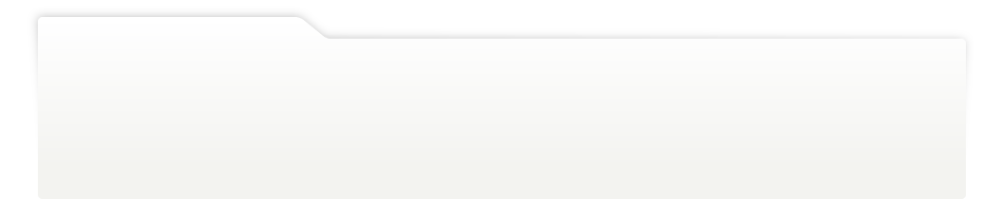
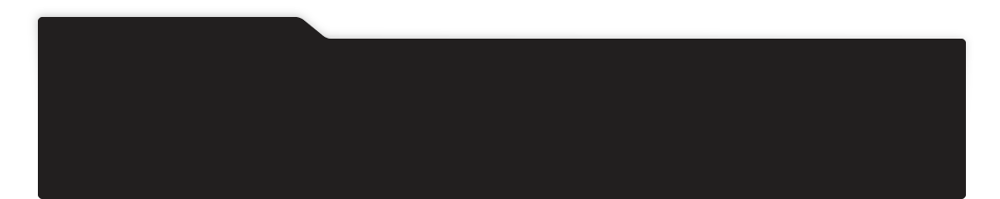
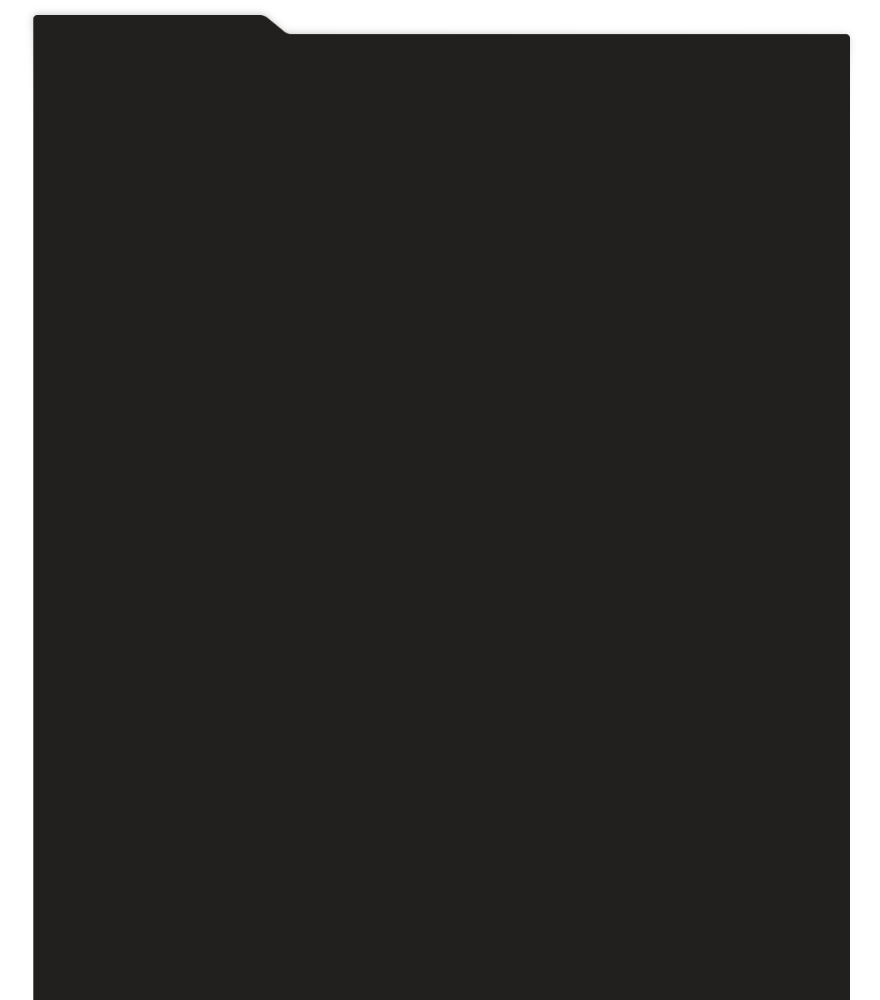
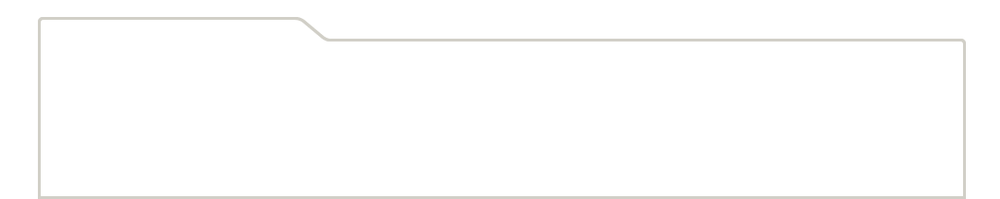
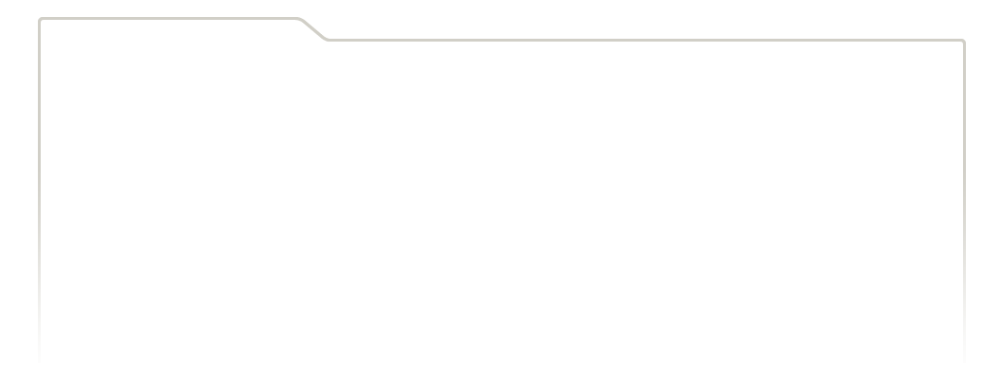
...
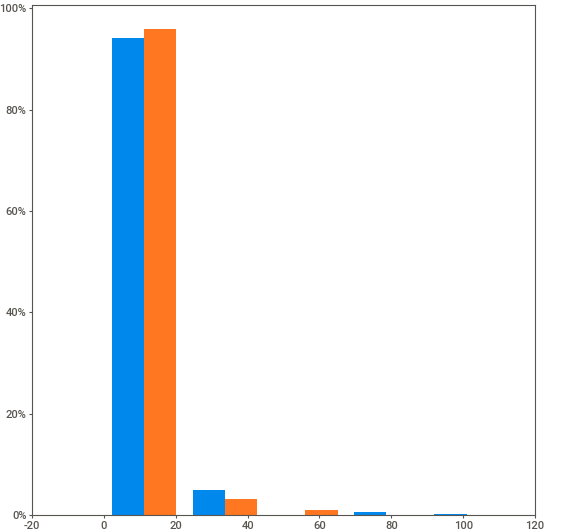
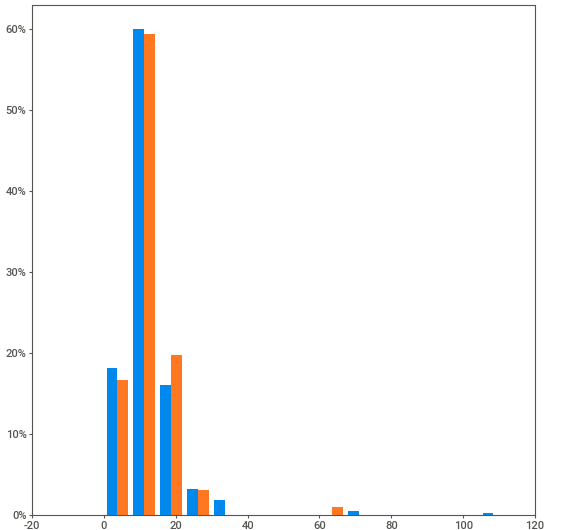
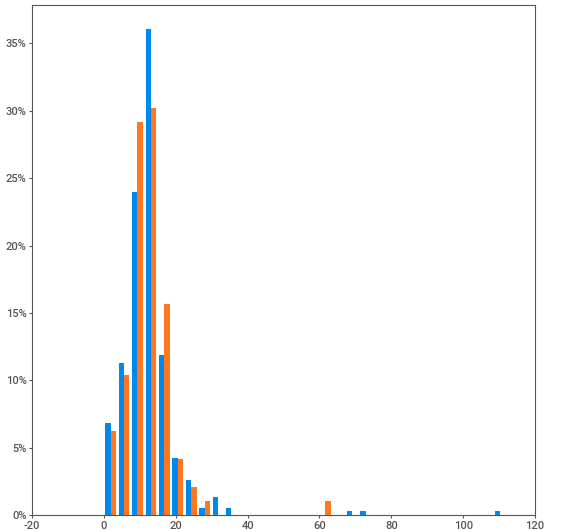
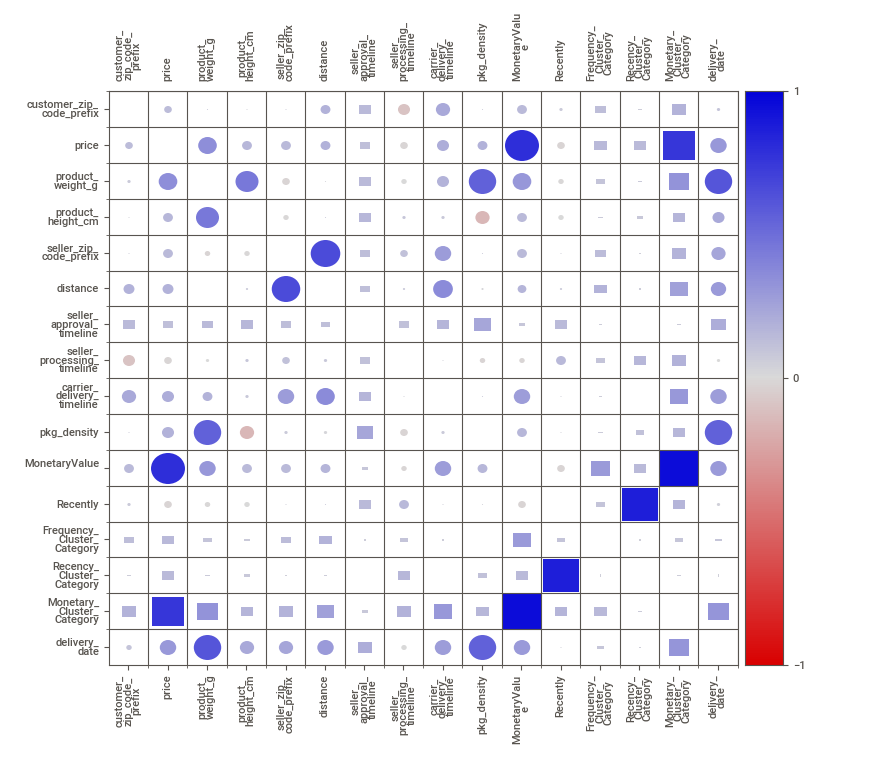
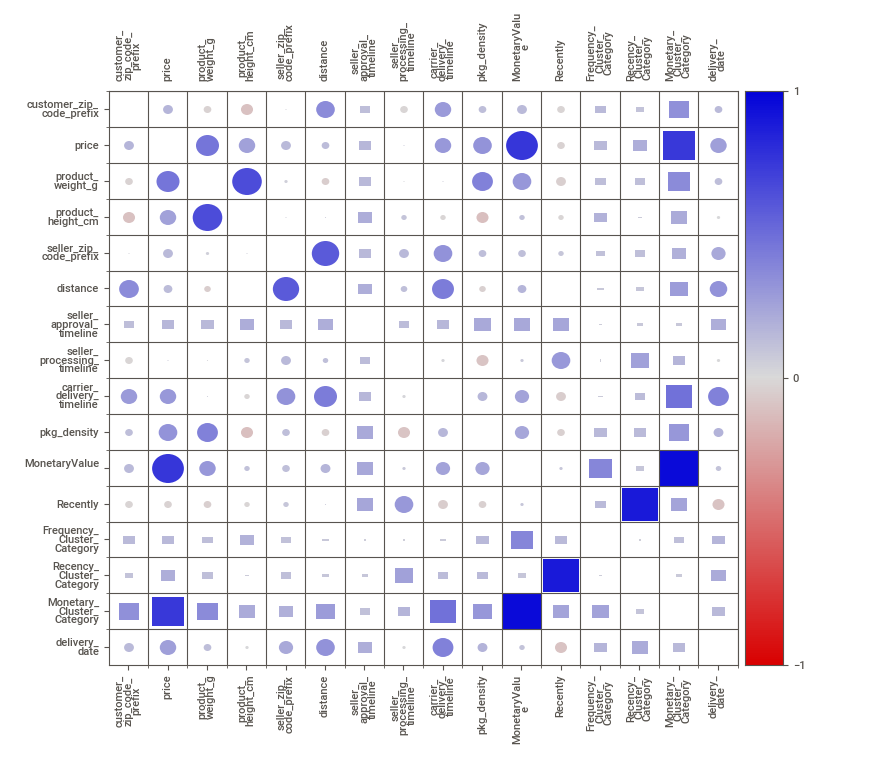

In [ ]:
comparison_report.show_notebook() # Using the default values (w="100%", h=750, layout="vertical"), all can be overridden in an INI, see below)

##### **ML MODELS**

###### **MULLER LOOP**

In [ ]:
#standardization
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_norm = scaler.fit_transform(X_train)
X_test_norm = scaler.fit_transform(X_test)

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import BayesianRidge
from sklearn.neural_network import MLPRegressor
from time import time
from sklearn.metrics import r2_score

names = ["RandomForestRegressor",
         "DecisionTreeRegressor", "SVR", "LinearRegression", "Ridge",
         "BayesianRidge","MLPRegressor"]

classifiers = [
    RandomForestRegressor(max_depth=2, random_state=0),
    DecisionTreeRegressor(max_depth=2, random_state=0),
    SVR(epsilon=0.2),
    LinearRegression(),
    Ridge(alpha=1.0),
    BayesianRidge(),
    MLPRegressor(random_state=1, max_iter=5000)
    ]

max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time()
    clf.fit(X_train_norm, y_train)
    ypred = clf.predict(X_test_norm)
    score = 100.0 * r2_score(y_test, ypred, multioutput='variance_weighted')
    print('Regression = %s, R2 Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time() - start_time))
    
    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Regression = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))
#plot the output of the various algorithms

Regression = RandomForestRegressor, R2 Score (test, accuracy) = 84.99, Training time = 0.31 seconds
Regression = DecisionTreeRegressor, R2 Score (test, accuracy) = 26.16, Training time = 0.00 seconds
Regression = SVR, R2 Score (test, accuracy) = 37.50, Training time = 0.02 seconds
Regression = LinearRegression, R2 Score (test, accuracy) = 94.39, Training time = 0.00 seconds
Regression = Ridge, R2 Score (test, accuracy) = 94.64, Training time = 0.00 seconds
Regression = BayesianRidge, R2 Score (test, accuracy) = 94.39, Training time = 0.00 seconds
Regression = MLPRegressor, R2 Score (test, accuracy) = 92.30, Training time = 3.86 seconds
--------------------------------------------------------------------------------
Best --> Regression = Ridge, Score (test, accuracy) = 94.64


##### **INTERACTIVE DASHBOARDS**

In [ ]:
#RandomForestRegressor
model1 = RandomForestRegressor(max_depth=2, random_state=0)
model1.fit(X_train, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=2, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=0, verbose=0, warm_start=False)

In [ ]:
#DecisionTreeRegressor
model2 = DecisionTreeRegressor(max_depth=2, random_state=0)
model2.fit(X_train, y_train)

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=2,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=0, splitter='best')

In [ ]:
#SVR
model3 = SVR(epsilon=0.2)
model3.fit(X_train, y_train)

SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.2, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [ ]:
#Linear Regression
model4 = LinearRegression()
model4.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

**EXPLAINER DASHBOARD**

In [ ]:
from explainerdashboard import RegressionExplainer,ExplainerDashboard
explainer1 = RegressionExplainer(model1, X_test,y_test)
ExplainerDashboard(explainer1).run(mode='inline')

Changing class type to RandomForestRegressionExplainer...
Generating self.shap_explainer = shap.TreeExplainer(model)
Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
Generating layout...
Calculating shap values...
Calculating predictions...
Calculating residuals...
Calculating absolute residuals...
Calculating shap interaction values...
Reminder: TreeShap computational complexity is O(TLD^2), where T is the number of trees, L is the maximum number of leaves in any tree and D the maximal depth of any tree. So reducing these will speed up the calculation.
Calculating dependencies...
Calculating importances...
Calculating ShadowDecTree for each individual decision tree...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Starting ExplainerDashboard inline (terminate it with ExplainerDashboard

<IPython.core.display.Javascript object>

**EXPLAINERHUB**

In [ ]:
#Creating Dashbord
from explainerdashboard import RegressionExplainer,ExplainerDashboard,ExplainerHub
explainer1 = RegressionExplainer(model1, X_test,y_test)
explainer2 = RegressionExplainer(model2, X_test,y_test)
explainer3 = RegressionExplainer(model3, X_test,y_test)
explainer4 = RegressionExplainer(model4, X_test,y_test)

Changing class type to RandomForestRegressionExplainer...
Generating self.shap_explainer = shap.TreeExplainer(model)
Generating self.shap_explainer = shap.TreeExplainer(model)
Generating self.shap_explainer = shap.KernelExplainer(model, X)...
Generating self.shap_explainer = shap.LinearExplainer(modelX)...


In [ ]:
db1 = ExplainerDashboard(explainer1)
db2 = ExplainerDashboard(explainer2)
db3 = ExplainerDashboard(explainer2)
db4 = ExplainerDashboard(explainer2)

Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
Generating layout...
Calculating shap values...
Calculating predictions...
Calculating residuals...
Calculating absolute residuals...
Calculating shap interaction values...
Reminder: TreeShap computational complexity is O(TLD^2), where T is the number of trees, L is the maximum number of leaves in any tree and D the maximal depth of any tree. So reducing these will speed up the calculation.
Calculating dependencies...
Calculating importances...
Calculating ShadowDecTree for each individual decision tree...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating l

In [ ]:
#run dashboard hub
#hub = ExplainerHub([db1, db2, db3, db4])
#hub.run()

### **CLASSIFICATION USECASE1 - DETERMINE THE PRODUCT CATEGORY**

*Classifiing product category type based on product dimensions,price,freight cost and multiple factors.*

In [ ]:
import pandas as pd
test=pd.read_csv('/content/testing_regression.csv')

In [ ]:
test.dtypes

seller_on_time                   float64
seller_order_approval_time       float64
review_score                     float64
reliabilty_score                 float64
customer_id                       object
customer_zip_code_prefix           int64
price                            float64
freight_value                    float64
product_weight_g                 float64
product_length_cm                float64
product_height_cm                float64
product_width_cm                 float64
product_category_name_english     object
seller_zip_code_prefix             int64
distance                         float64
actual_delivery_timeline           int64
seller_approval_timeline           int64
seller_processing_timeline         int64
seller_order_timeline              int64
carrier_delivery_timeline          int64
customer_satisfaction              int64
pkg_density                      float64
dtype: object

In [ ]:
#created a simple map of product category
product_category_dictinary = {y:x for x,y in enumerate(test['product_category_name_english'].unique())}
test['product_category_name_english'] = test['product_category_name_english'].map(product_category_dictinary)

In [ ]:
#total no of product categories
len(product_category_dictinary)

69

In [ ]:
#find count of orders based on product category
test.groupby('product_category_name_english')['customer_zip_code_prefix'].count().sort_values(ascending=False)

product_category_name_english
3     7942
20    5765
4     5726
18    4765
22    4044
      ... 
58      14
63      13
46      11
61       7
65       4
Name: customer_zip_code_prefix, Length: 69, dtype: int64

In [ ]:
#filtering and selecting only 4 product categories due to huge volumne of data.
top_3 = test[test['product_category_name_english'].isin([3,20,4])]

In [ ]:
top_3

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_id,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,...,product_category_name_english,seller_zip_code_prefix,distance,actual_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,customer_satisfaction,pkg_density
191,1.0,1.0,0.8,0.94,46e062b89efcb2d995e223cdf27783d5,27525,105.00,23.31,1650.0,36.0,...,3,14940,280.61,29,0,0,-4,29,1,4.87
192,1.0,1.0,0.8,0.94,6815bf204e3baca2b1b0fa5d285d3c99,96015,82.99,23.16,1450.0,34.0,...,3,14940,724.69,34,0,0,-6,33,1,5.55
193,1.0,1.0,0.8,0.94,045113dd9def11da63eed78d7bd66571,13212,170.00,18.10,2800.0,44.0,...,3,14940,158.01,7,0,0,-6,6,0,11.68
194,1.0,1.0,0.8,0.94,2a888c1244dc79321e00770c3b56268e,13212,117.99,16.46,2700.0,45.0,...,3,14940,158.01,15,0,1,-5,13,0,8.23
195,1.0,1.0,0.8,0.94,5039a0deaaeb41b8cd4135964d681bb6,24431,69.90,17.74,950.0,29.0,...,3,14940,374.37,15,0,0,-8,15,0,8.18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67643,1.0,1.0,0.9,0.97,f7c4276a2a1197f38b8a1c037aa11711,41810,54.90,23.10,500.0,25.0,...,20,81260,1118.85,15,1,3,-2,10,0,3.12
67644,1.0,1.0,0.9,0.97,d12dabdce587c93902dacb61c8c6f6b4,4546,59.90,15.52,500.0,25.0,...,20,81260,212.29,5,0,0,-4,5,0,3.12
67645,1.0,1.0,0.9,0.97,10b3c5bcb5211413451e40aa64ffc772,2871,59.90,15.52,500.0,25.0,...,20,81260,218.27,9,0,1,-1,8,0,3.12
67646,1.0,1.0,0.9,0.97,a59d04c9a76861580b6b7c3491570a5b,20051,59.90,18.57,500.0,25.0,...,20,81260,427.36,7,0,3,-1,3,0,3.12


In [ ]:
#merged_top3 = pd.merge(top_3,GOlder_Cluster)

In [ ]:
#merged_top3

#### **DIFFERENT FEATURES IN THE DATASET**

In [ ]:
X=top_3.drop(columns=['product_category_name_english','customer_id'])
y=top_3['product_category_name_english']

In [ ]:
#features in the dataset
feature_name=X.columns
feature_name

Index(['seller_on_time', 'seller_order_approval_time', 'review_score',
       'reliabilty_score', 'customer_zip_code_prefix', 'price',
       'freight_value', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm', 'seller_zip_code_prefix',
       'distance', 'actual_delivery_timeline', 'seller_approval_timeline',
       'seller_processing_timeline', 'seller_order_timeline',
       'carrier_delivery_timeline', 'customer_satisfaction', 'pkg_density'],
      dtype='object')

#### **DIFFERENT FEATURE SELECTION METHODS**

#####**Pearson Correlation**

In [ ]:
def cor_selector(X, y,num_feats):
    cor_list = []
    feature_name = X.columns.tolist()
    cor_list = X.corrwith(y)
    # replace NaN with 0
    cor_list = [0 if np.isnan(i) else i for i in cor_list]
    # feature name
    cor_feature = X.iloc[:,np.argsort(np.abs(cor_list))[-num_feats:]].columns.tolist()
    # feature selection? 0 for not select, 1 for select
    cor_support = [True if i in cor_feature else False for i in feature_name]
    return cor_support, cor_feature

In [ ]:
import numpy as np
num_feats=10
cor_support, cor_feature = cor_selector(X, y,num_feats)
print(str(len(cor_feature)), 'selected features')

10 selected features


In [ ]:
for x in cor_feature:
  print(x)

freight_value
distance
customer_zip_code_prefix
seller_processing_timeline
product_length_cm
reliabilty_score
review_score
product_height_cm
seller_zip_code_prefix
product_width_cm


#####**CHI-SQUARED**

In [ ]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.preprocessing import MinMaxScaler
X_norm = MinMaxScaler().fit_transform(X)
chi_selector = SelectKBest(chi2, k=num_feats)
chi_selector.fit(X_norm, y)
chi_support = chi_selector.get_support()
chi_feature = X.loc[:,chi_support].columns.tolist()
print(str(len(chi_feature)), 'selected features')

10 selected features


In [ ]:
for x in cor_feature:
  print(x)

freight_value
distance
customer_zip_code_prefix
seller_processing_timeline
product_length_cm
reliabilty_score
review_score
product_height_cm
seller_zip_code_prefix
product_width_cm


#####**Recursive Feature Elimination**

In [ ]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
rfe_selector = RFE(estimator=LogisticRegression(), n_features_to_select=num_feats, step=10, verbose=5)
rfe_selector.fit(X_norm, y)
rfe_support = rfe_selector.get_support()
rfe_feature = X.loc[:,rfe_support].columns.tolist()
print(str(len(rfe_feature)), 'selected features')

Fitting estimator with 20 features.
10 selected features


In [ ]:
rfe_feature

['seller_on_time',
 'review_score',
 'price',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'product_width_cm',
 'actual_delivery_timeline',
 'carrier_delivery_timeline',
 'pkg_density']

#####**Lasso: SelectFromModel**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LogisticRegression

embeded_lr_selector = SelectFromModel(LogisticRegression(penalty="l2"), max_features=num_feats)
embeded_lr_selector.fit(X_norm, y)

embeded_lr_support = embeded_lr_selector.get_support()
embeded_lr_feature = X.loc[:,embeded_lr_support].columns.tolist()
print(str(len(embeded_lr_feature)), 'selected features')

6 selected features


In [ ]:
embeded_lr_feature

['review_score',
 'price',
 'product_weight_g',
 'product_height_cm',
 'product_width_cm',
 'pkg_density']

#####**Tree-based: SelectFromModel**

In [ ]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier

embeded_rf_selector = SelectFromModel(RandomForestClassifier(n_estimators=100), max_features=num_feats)
embeded_rf_selector.fit(X, y)

embeded_rf_support = embeded_rf_selector.get_support()
embeded_rf_feature = X.loc[:,embeded_rf_support].columns.tolist()
print(str(len(embeded_rf_feature)), 'selected features')

7 selected features


In [ ]:
embeded_rf_feature

['price',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'product_width_cm',
 'seller_zip_code_prefix',
 'pkg_density']

##### **COMBINE ALL METHODS AND CHOOSE TOP N FEATURES**

In [ ]:
# put all selection together
feature_selection_df = pd.DataFrame({'Feature':feature_name, 'Pearson':cor_support, 'Chi-2':chi_support, 'RFE':rfe_support, 'Logistics':embeded_lr_support,
                                    'Random Forest':embeded_rf_support})
# count the selected times for each feature
feature_selection_df['Total'] = np.sum(feature_selection_df, axis=1)
# display the top 100
feature_selection_df = feature_selection_df.sort_values(['Total','Feature'] , ascending=False)
feature_selection_df.index = range(1, len(feature_selection_df)+1)

In [ ]:
feature_selection_df

,Feature,Pearson,Chi-2,RFE,Logistics,Random Forest,Total
1,product_width_cm,True,True,True,True,True,5
2,product_height_cm,True,True,True,True,True,5
3,review_score,True,True,True,True,False,4
4,product_weight_g,False,True,True,True,True,4
5,product_length_cm,True,True,True,False,True,4
6,price,False,True,True,True,True,4
7,seller_zip_code_prefix,True,True,False,False,True,3
8,pkg_density,False,False,True,True,True,3
9,distance,True,True,False,False,False,2
10,customer_zip_code_prefix,True,True,False,False,False,2


In [ ]:
#select top 10 features
final_features = feature_selection_df[:9]['Feature']

In [ ]:
final_features = final_features.values

In [ ]:
final_features

array(['product_width_cm', 'product_height_cm', 'review_score',
       'product_weight_g', 'product_length_cm', 'price',
       'seller_zip_code_prefix', 'pkg_density', 'distance'], dtype=object)

In [ ]:
#columns to drop
drop_columns=[]

for col in X.columns:
  if col in final_features:
    pass
  else:
    drop_columns.append(col)

In [ ]:
drop_columns

['seller_on_time',
 'seller_order_approval_time',
 'reliabilty_score',
 'customer_zip_code_prefix',
 'freight_value',
 'actual_delivery_timeline',
 'seller_approval_timeline',
 'seller_processing_timeline',
 'seller_order_timeline',
 'carrier_delivery_timeline',
 'customer_satisfaction']

In [ ]:
#drop unnecessary features 
Final_X = X.drop(columns=drop_columns)

In [ ]:
#dataframe with only the required features
Final_X

,review_score,price,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,distance,pkg_density
191,0.8,105.00,1650.0,36.0,14.0,42.0,14940,280.61,4.87
192,0.8,82.99,1450.0,34.0,12.0,40.0,14940,724.69,5.55
193,0.8,170.00,2800.0,44.0,10.0,34.0,14940,158.01,11.68
194,0.8,117.99,2700.0,45.0,13.0,35.0,14940,158.01,8.23
195,0.8,69.90,950.0,29.0,10.0,25.0,14940,374.37,8.18
...,...,...,...,...,...,...,...,...,...
67643,0.9,54.90,500.0,25.0,20.0,20.0,81260,1118.85,3.12
67644,0.9,59.90,500.0,25.0,20.0,20.0,81260,212.29,3.12
67645,0.9,59.90,500.0,25.0,20.0,20.0,81260,218.27,3.12
67646,0.9,59.90,500.0,25.0,20.0,20.0,81260,427.36,3.12


#### **PERFROM CLASSIFICATION**

In [ ]:
from pycaret.classification import *

In [ ]:
Classification_Df = Final_X

In [ ]:
Classification_Df['product_category_name_english']=y

In [ ]:
#setup pycaret
exp_name = setup(data = Classification_Df,  target = 'product_category_name_english',normalize=True,remove_outliers=True,silent=True)

,Description,Value
0,session_id,5236
1,Target,product_category_name_english
2,Target Type,Multiclass
3,Label Encoded,None
4,Original Data,"(19433, 10)"
5,Missing Values,False
6,Numeric Features,9
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


##### **EDA - AUTOVIZ**

Alert! from version 0.1.36. After importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
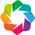

Shape of your Data Set loaded: (19433, 10)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    Number of Numeric Columns =  8
    Number of Integer-Categorical Columns =  1
    Number of String-Categorical Columns =  0
    Number of Factor-Categorical Columns =  0
    Number of String-Boolean Columns =  0
    Number of Numeric-Boolean Columns =  0
    Number of Discrete String Columns =  0
    Number of NLP String Columns =  0
    Number of Date Time Columns =  0
    Number of ID Columns =  0
    Number of Columns to Delete =  0
    9 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Multi_Classification VISUALIZATION Started #####################
Data Set Shape: 19433 rows, 10 cols
Data Set columns info:
* review_score: 0 nulls, 9 unique vals, most common: {0.8: 11655, 0.9: 5523}
* price: 0 nulls, 1743 unique vals, most common: {89.9: 573,

Row
    [0] WidgetBox
        [0] Select(name='y', options=['price', 'product_weight_...], value='price')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['price', 'product_weight_...], value='price')
        [1] Select(name='Y-Axis', options=['price', 'product_weight_...], value='product_weight_g')
        [2] Select(name='Color', options=['None', 'product_category...], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['seller_zip_code_prefix']...], value='seller_zip_code_prefix', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['product_length_cm', ...], value='product_length_cm', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

No date vars could be found in data set


HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['seller_zip_code_prefix',...], value='seller_zip_code_prefix')
        [1] Select(name='Y-Axis', options=['price', 'product_weight_...], value='product_weight_g')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 10


In [ ]:
# perfrom eda
%matplotlib inline
eda(display_format = 'bokeh',verbose=1)

##### **COMPARE DIFFERENT MODEL ACCURACY USING PYCARET AUTOML**

In [ ]:
Classification_Df['product_category_name_english']=Classification_Df['product_category_name_english'].map({3:0,20:1,4:2})

In [ ]:
classificaiton_models = setup(data = Classification_Df,  target = 'product_category_name_english',normalize=True,silent=True,remove_outliers=True)

,Description,Value
0,session_id,4091
1,Target,product_category_name_english
2,Target Type,Multiclass
3,Label Encoded,None
4,Original Data,"(19433, 10)"
5,Missing Values,False
6,Numeric Features,9
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


In [ ]:
best_classification_model = compare_models(fold=3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9588,0.9953,0.9552,0.9590,0.9589,0.9374,0.9374,0.7500
rf,Random Forest Classifier,0.9568,0.9965,0.9532,0.9570,0.9569,0.9343,0.9344,1.5433
et,Extra Trees Classifier,0.9560,0.9969,0.9523,0.9563,0.9561,0.9331,0.9332,1.1333
dt,Decision Tree Classifier,0.9345,0.9522,0.9290,0.9346,0.9345,0.9004,0.9004,0.0767
gbc,Gradient Boosting Classifier,0.9026,0.9817,0.8943,0.9033,0.9028,0.8519,0.8520,4.4367
knn,K Neighbors Classifier,0.8781,0.9620,0.8669,0.8771,0.8773,0.8141,0.8143,0.5333
ada,Ada Boost Classifier,0.7683,0.8918,0.7482,0.7686,0.7677,0.6476,0.6482,0.5533
lr,Logistic Regression,0.7295,0.8789,0.7074,0.7294,0.7263,0.5879,0.5905,0.1533
ridge,Ridge Classifier,0.7181,0.0000,0.6935,0.7164,0.7119,0.5695,0.5737,0.0400
lda,Linear Discriminant Analysis,0.7153,0.8764,0.6974,0.7254,0.7169,0.5688,0.5718,0.0567


##### **TRAIN TEST VALIDATION SPLIT**

In [ ]:
sample_Df=Classification_Df.sample(n=2000)

In [ ]:
from fast_ml.model_development import train_valid_test_split
X_train, y_train, X_valid, y_valid, X_test, y_test = train_valid_test_split(sample_Df, target = 'product_category_name_english', 
                                                                            train_size=0.7, valid_size=0.2, test_size=0.1)

#####**VISUALIZE TRAIN_TEST_SPLIT USING SWEETVIZ**

In [ ]:
# importing sweetviz
import sweetviz as sv

training_date = X_train
training_date['product_category_name_english']= y_train

testing_data = X_test
testing_data['product_category_name_english']= y_test

#compare train and test
comparison_report = sv.compare([training_date,'Train'], [testing_data,'Test'])

                                             |          | [  0%]   00:00 -> (? left)


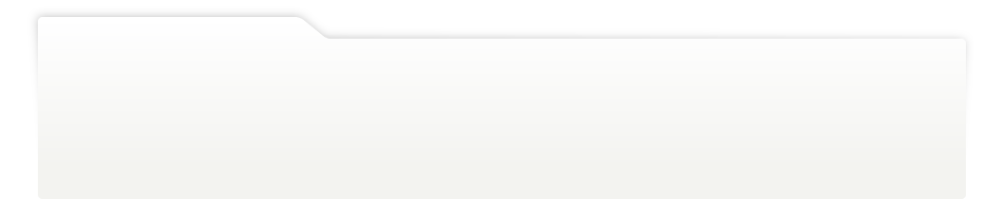
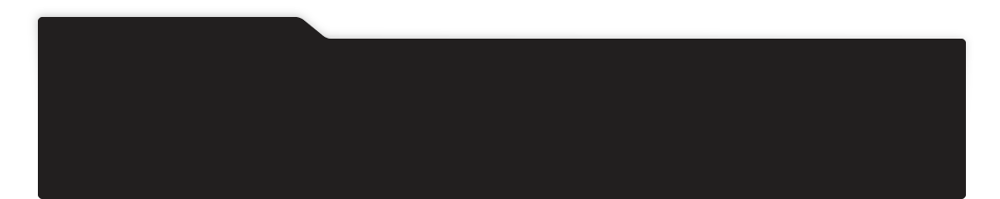
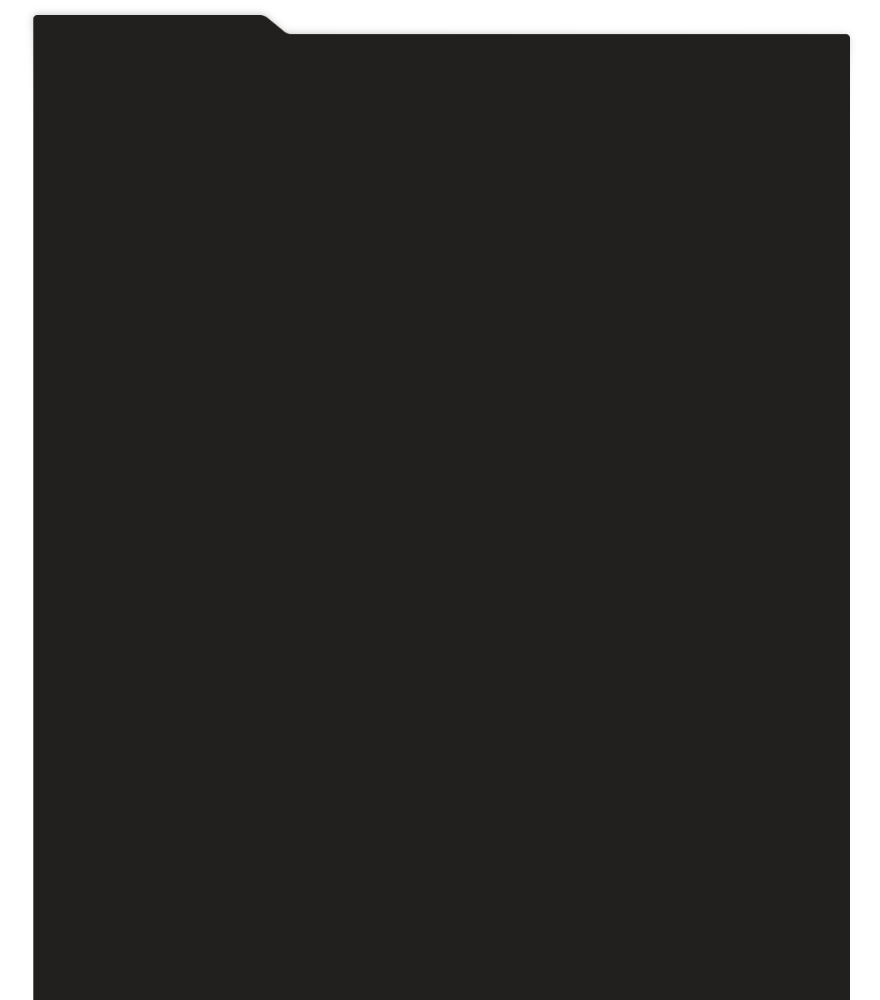
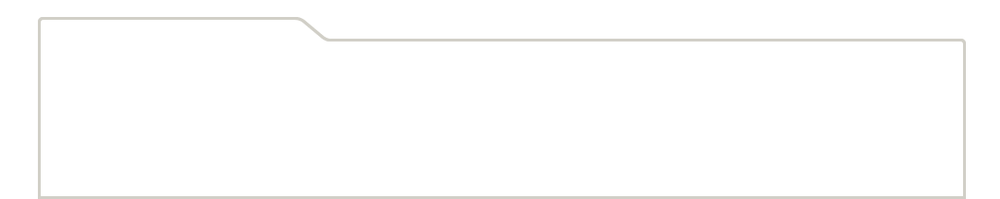
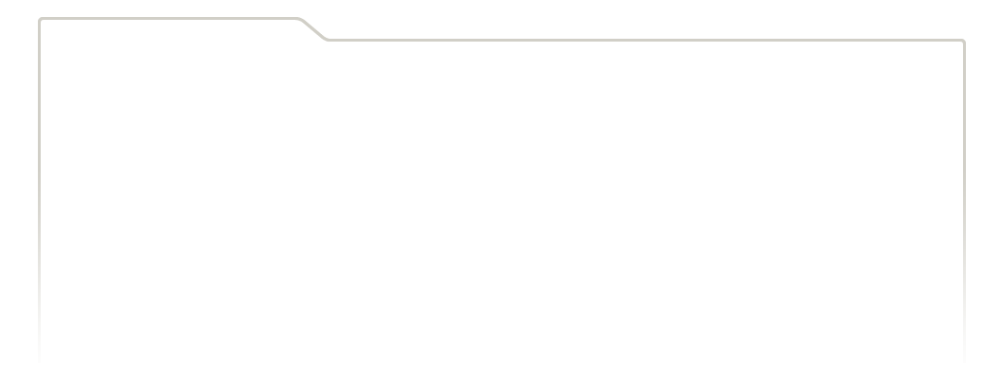
...
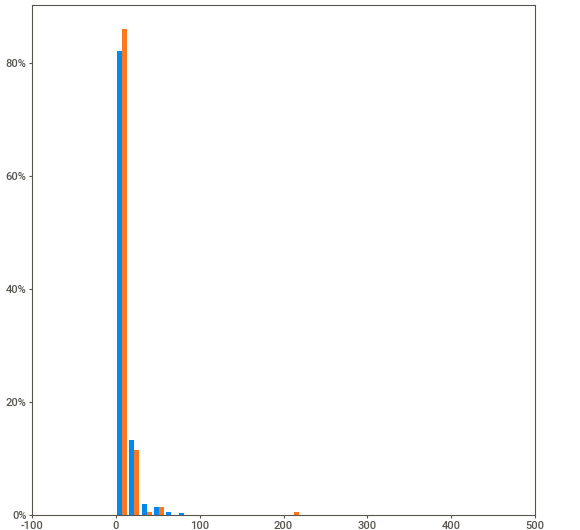
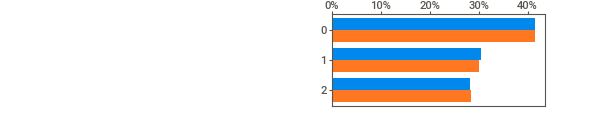
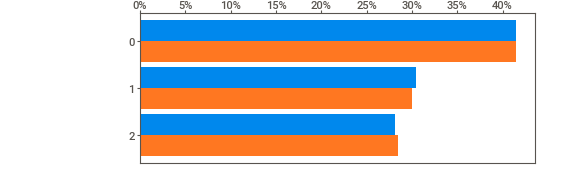
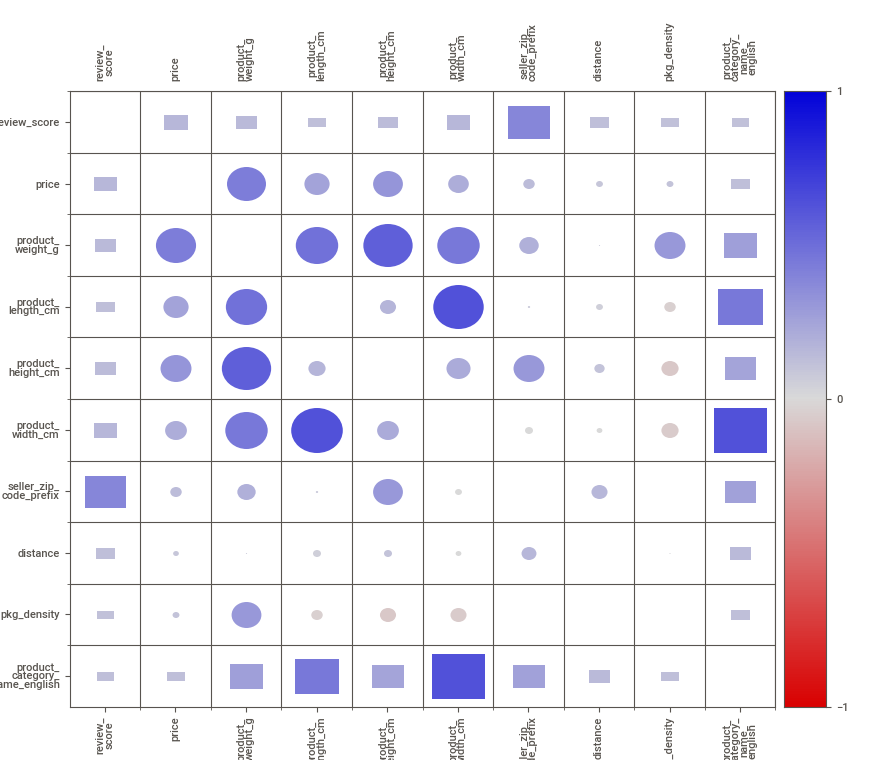
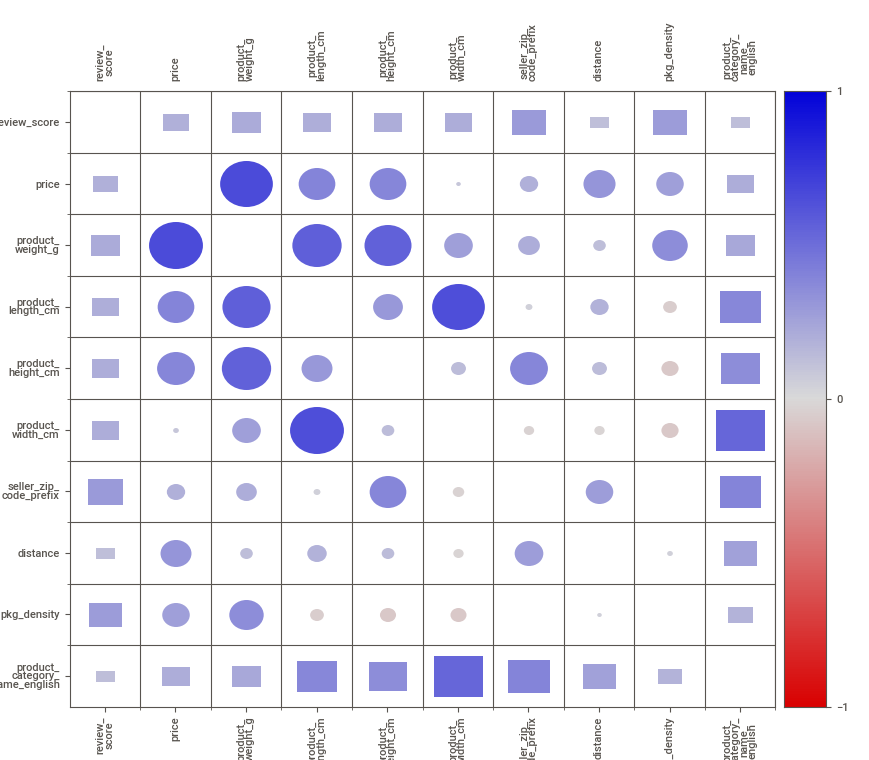

In [ ]:
comparison_report.show_notebook() # Using the default values (w="100%", h=750, layout="vertical"), all can be overridden in an INI, see below)

#####**ML MODEL - MULLER LOOP CLASSIFIER**

In [ ]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from time import time

names = ["Nearest Neighbors",
         "Decision Tree", "Random Forest", "AdaBoost",
         "Naive Bayes"]

classifiers = [
    KNeighborsClassifier(3),
    DecisionTreeClassifier(),
    RandomForestClassifier(n_estimators=10, max_features=1),
    AdaBoostClassifier(),
    GaussianNB()]

max_score = 0.0
max_class = ''
# iterate over classifiers
for name, clf in zip(names, classifiers):
    start_time = time()
    clf.fit(X_train, y_train)
    score = 100.0 * clf.score(X_test, y_test)
    print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time() - start_time))
    
    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

print(80*'-' )
print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))
#plot the output of the various algorithms

Classifier = Nearest Neighbors, Score (test, accuracy) = 80.50, Training time = 0.03 seconds
Classifier = Decision Tree, Score (test, accuracy) = 100.00, Training time = 0.01 seconds
Classifier = Random Forest, Score (test, accuracy) = 99.00, Training time = 0.05 seconds
Classifier = AdaBoost, Score (test, accuracy) = 100.00, Training time = 0.28 seconds
Classifier = Naive Bayes, Score (test, accuracy) = 70.50, Training time = 0.01 seconds
--------------------------------------------------------------------------------
Best --> Classifier = Decision Tree, Score (test, accuracy) = 100.00


##### **INTERACTIVE DASHBOARDS**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from fast_ml.model_development import train_valid_test_split
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier

In [ ]:
#random forest
model1 = RandomForestClassifier(n_estimators=100,criterion='gini',random_state=5225,verbose=0,n_jobs=-1)
model1.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_state=5225, verbose=0,
                       warm_start=False)

In [ ]:
#knn
model2 = KNeighborsClassifier(n_neighbors=3)
model2.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=3, p=2,
                     weights='uniform')

In [ ]:
#Gaussina NB
model3 = GaussianNB()
model3.fit(X_train, y_train)

GaussianNB(priors=None, var_smoothing=1e-09)

In [ ]:
#Adaboost classifier
model4 = AdaBoostClassifier()
model4.fit(X_train, y_train)

AdaBoostClassifier(algorithm='SAMME.R', base_estimator=None, learning_rate=1.0,
                   n_estimators=50, random_state=None)

In [ ]:
#Creating Dashbord
from explainerdashboard import ClassifierExplainer,ExplainerDashboard,ExplainerHub
explainer1 = ClassifierExplainer(model1, X_train,y_train)
explainer2 = ClassifierExplainer(model2, X_train,y_train)
explainer3 = ClassifierExplainer(model3, X_train,y_train)
explainer4 = ClassifierExplainer(model4, X_train,y_train)

Detected RandomForestClassifier model: Changing class type to RandomForestClassifierExplainer...
Note: model_output=='probability', so assuming that raw shap output of RandomForestClassifier is in probability space...
Generating self.shap_explainer = shap.TreeExplainer(model)
Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')
Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity')
Note: shap values for shap='kernel' normally get calculated against X_background, but paramater X_background=None, so setting X_background=shap.sample(X, 50)...
Generating self.shap_explainer = shap.KernelExplainer(model, X, link='identity

In [ ]:
db1 = ExplainerDashboard(explainer1)
db2 = ExplainerDashboard(explainer2)
db3 = ExplainerDashboard(explainer2)
db4 = ExplainerDashboard(explainer2)

Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
Generating layout...
Calculating shap values...
Calculating prediction probabilities...
Calculating metrics...
Calculating confusion matrices...
Calculating classification_dfs...
Calculating roc auc curves...
Calculating pr auc curves...
Calculating liftcurve_dfs...
Calculating shap interaction values... (this may take a while)
Reminder: TreeShap computational complexity is O(TLD^2), where T is the number of trees, L is the maximum number of leaves in any tree and D the maximal depth of any tree. So reducing these will speed up the calculation.
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating predictions...
Calculating pred_percentiles...
Calculating ShadowDecTree for each individual decision tree...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e

  0%|          | 0/1400 [00:00<?, ?it/s]

Calculating prediction probabilities...
Calculating metrics...
Calculating confusion matrices...
Calculating classification_dfs...
Calculating roc auc curves...
Calculating pr auc curves...
Calculating liftcurve_dfs...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating predictions...
Calculating pred_percentiles...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
For this type of model and model_output interactions don't work, so setting shap_interaction=False...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating dependencies...
Reminder: you can store the explainer (including calculated dependencies) wit

**EXPLANER DASHBOARD**

In [ ]:
db1.run(mode='inline')

Starting ExplainerDashboard inline (terminate it with ExplainerDashboard.terminate(8050))


<IPython.core.display.Javascript object>

**EXPLAINERHUB**

In [ ]:
#run dashboard
#hub = ExplainerHub([db1, db2, db3, db4])
#hub.run(port=9050)

**INLINE DASHBOARD**

In [ ]:
new_X = Final_X.drop(columns=['product_category_name_english'])
new_X = X.loc[:,new_X.columns]
#y=y.map({3:0,20:1,4:2})

In [ ]:
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from time import time
from sklearn.model_selection import train_test_split
from sklearn.metrics import plot_confusion_matrix
from yellowbrick.classifier import ROCAUC

def plot_ROC_curve(model, xtrain, ytrain, xtest, ytest):

    # Creating visualization with the readable labels
    visualizer = ROCAUC(model, encoder={0: 'functional', 
                                        1: 'needs repair', 
                                        2: 'nonfunctional'})                                    
    # Fitting to the training data first then scoring with the test data                                    
    visualizer.fit(xtrain, ytrain)
    visualizer.score(xtest, ytest)
    return visualizer

def muller(X,y):
  names = ["Nearest Neighbors",
          "Decision Tree", "Random Forest", "AdaBoost",
          "Naive Bayes"]
  
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=21)
  classifiers = [
      KNeighborsClassifier(3),
      DecisionTreeClassifier(),
      RandomForestClassifier(n_estimators=10, max_features=1),
      AdaBoostClassifier(),
      GaussianNB()]
  max_score = 0.0
  max_class = ''
  # iterate over classifiers
  for name, clf in zip(names, classifiers):
      start_time = time()
      clf.fit(X_train, y_train)
      score = 100.0 * clf.score(X_test, y_test)
      print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score), 'Training time = %.2f seconds' % (time() - start_time))
      if score > max_score:
          clf_best = clf
          max_score = score
          max_class = name

  print(80*'-' )
  print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))
  return clf_best,X_test,y_test,X_train,y_train

In [273]:
def on_button_clicked(b):
  fig, ax = plt.subplots(1,2)
  global new_X
  global y
  global checkbox
  only_selected_values=[]
  for x in checkbox:
    if checkbox[x].value==True:
      only_selected_values.append(checkbox[x].description)
  final_X = new_X.loc[:,only_selected_values]
  oversample = SMOTE()
  resampled_X, resampled_y = oversample.fit_resample(final_X,y)
  original_class_distribution = Counter(resampled_y)
  strategy = {0:original_class_distribution[0]+round((slider1.value/100)*len(resampled_X)), 1:original_class_distribution[1]+round((slider2.value/100)*len(resampled_X)), 2:original_class_distribution[2]+round((slider3.value/100)*len(resampled_X))}
  oversample1 = SMOTE(sampling_strategy=strategy)
  resampled_X1, resampled_y1 = oversample1.fit_resample(resampled_X,resampled_y)
  best_classifier,X_test, y_test,X_train,y_train = muller(resampled_X1,resampled_y1)
  plot_confusion_matrix(best_classifier,X_test,y_test,ax=ax[0])
  plot_ROC_curve(best_classifier,X_train,y_train,X_test,y_test)
  plt.show()

In [280]:
from imblearn.over_sampling import SMOTE 
import ipywidgets as widgets
from IPython.display import display, clear_output
from collections import Counter
slider1 = widgets.IntSlider(min=0, max=100,description='Class 0',step=1)
slider2 = widgets.IntSlider(min=0, max=100,description='Class 1',step=1)
slider3 = widgets.IntSlider(min=0, max=100,description='Class 2',step=1)

print("Select Percentage of data distribution")
display(slider1,slider2,slider3)

Select Percentage of data distribution


IntSlider(value=0, description='Class 0')

IntSlider(value=0, description='Class 1')

IntSlider(value=0, description='Class 2')

In [279]:
checkbox={}
for x in new_X.columns:
    checkbox[x]=widgets.Checkbox(value=True,description=x)

print("Features selection for analysis")
for x in checkbox:
  display(checkbox[x])

Features selection for analysis


Checkbox(value=True, description='review_score')

Checkbox(value=True, description='price')

Checkbox(value=True, description='product_weight_g')

Checkbox(value=True, description='product_length_cm')

Checkbox(value=True, description='product_height_cm')

Checkbox(value=True, description='product_width_cm')

Checkbox(value=True, description='seller_zip_code_prefix')

Checkbox(value=True, description='distance')

Checkbox(value=True, description='pkg_density')

Button(description='Compute Metrics', style=ButtonStyle())

Classifier = Nearest Neighbors, Score (test, accuracy) = 98.02, Training time = 0.64 seconds
Classifier = Decision Tree, Score (test, accuracy) = 97.48, Training time = 0.22 seconds
Classifier = Random Forest, Score (test, accuracy) = 98.01, Training time = 0.39 seconds
Classifier = AdaBoost, Score (test, accuracy) = 79.04, Training time = 2.21 seconds
Classifier = Naive Bayes, Score (test, accuracy) = 65.93, Training time = 0.02 seconds
--------------------------------------------------------------------------------
Best --> Classifier = Nearest Neighbors, Score (test, accuracy) = 98.02


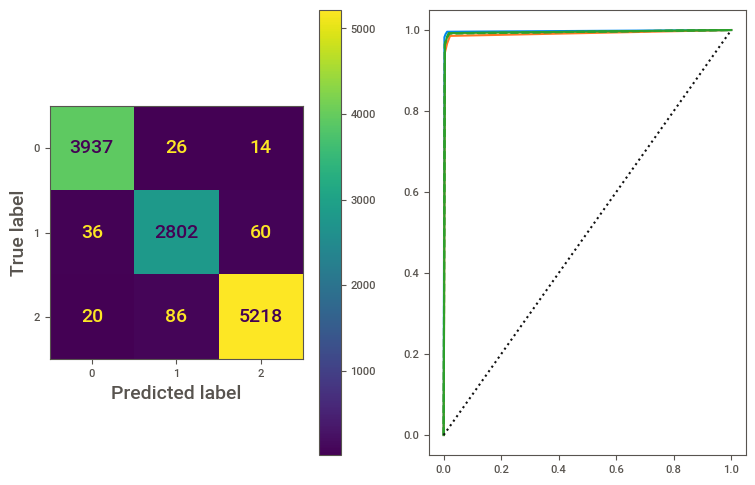

In [281]:
button = widgets.Button(description="Compute Metrics")
button.on_click(on_button_clicked)
display(button)